In [1]:
# update the git
! git add  .
! git commit -m "From Mac"
! git push

[master 1cdd66c1] From Mac
 6 files changed, 5657 insertions(+), 110 deletions(-)
 create mode 100644 NeuralNetwork/AAE/*** NORMALIZED GRADIENT ***. one by one.ipynb
 create mode 100644 NeuralNetwork/AAE/.ipynb_checkpoints/*** NORMALIZED GRADIENT ***. one by one-checkpoint.ipynb
 create mode 100644 NeuralNetwork/AAE/.ipynb_checkpoints/4. Norm G Tanh-checkpoint.ipynb
 create mode 100644 NeuralNetwork/AAE/4. Norm G Tanh.ipynb
Counting objects: 8, done.
Delta compression using up to 4 threads.
Compressing objects: 100% (8/8), done.
Writing objects: 100% (8/8), 3.18 MiB | 191.00 KiB/s, done.
Total 8 (delta 5), reused 0 (delta 0)
remote: Resolving deltas: 100% (5/5), completed with 4 local objects.
To https://github.com/JaeDukSeo/Daily-Neural-Network-Practice-2
   9870d118..1cdd66c1  master -> master


In [2]:
# import library
import matplotlib 
matplotlib.use('Agg')
%matplotlib inline
import numpy as np
import sys, os,cv2
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder
from skimage.transform import resize
from scipy.misc import imread
from imgaug import augmenters as iaa
import nibabel as nib
import imgaug as ia
from scipy.ndimage import zoom
from sklearn.utils import shuffle
import matplotlib.animation as animation

# Generate training data
import tensorflow as tf
old_v = tf.logging.get_verbosity()
tf.logging.set_verbosity(tf.logging.ERROR)
from tensorflow.examples.tutorials.mnist import input_data

plt.style.use('seaborn-white')
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
np.random.seed(6278)
tf.set_random_seed(6728)
ia.seed(6278)

In [3]:
# get the mnist data set
mnist = input_data.read_data_sets('../../Dataset/MNIST/', one_hot=True)
x_data, train_label, y_data, test_label = mnist.train.images, mnist.train.labels, mnist.test.images, mnist.test.labels
x_data_added,x_data_added_label = mnist.validation.images,mnist.validation.labels
x_data = x_data.reshape(-1, 28, 28, 1)  # 28x28x1 input img
y_data = y_data.reshape(-1, 28, 28, 1)  # 28x28x1 input img
x_data_added = x_data_added.reshape(-1, 28, 28, 1)
x_data = np.vstack((x_data,x_data_added))
train_label = np.vstack((train_label,x_data_added_label))

train_batch = np.zeros((20000,28,28,1))
test_batch = np.zeros((10000,28,28,1))
for iter in range(20000):
    train_batch[iter,:,:,:] = np.expand_dims(resize(x_data[iter,:,:,0],(28,28)),axis=3)

# print out the data shape and the max and min value
print(train_batch.shape)
print(train_batch.max())
print(train_batch.min())
print(train_label.shape)
print(train_label.max())
print(train_label.min())
print(test_batch.shape)
print(test_batch.max())
print(test_batch.min())
print(test_label.shape)
print(test_label.max())
print(test_label.min())

Extracting ../../Dataset/MNIST/train-images-idx3-ubyte.gz
Extracting ../../Dataset/MNIST/train-labels-idx1-ubyte.gz
Extracting ../../Dataset/MNIST/t10k-images-idx3-ubyte.gz
Extracting ../../Dataset/MNIST/t10k-labels-idx1-ubyte.gz


/anaconda3/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: DeprecationWarning: Both axis > a.ndim and axis < -a.ndim - 1 are deprecated and will raise an AxisError in the future.
  


(20000, 28, 28, 1)
1.0
0.0
(60000, 10)
1.0
0.0
(10000, 28, 28, 1)
0.0
0.0
(10000, 10)
1.0
0.0


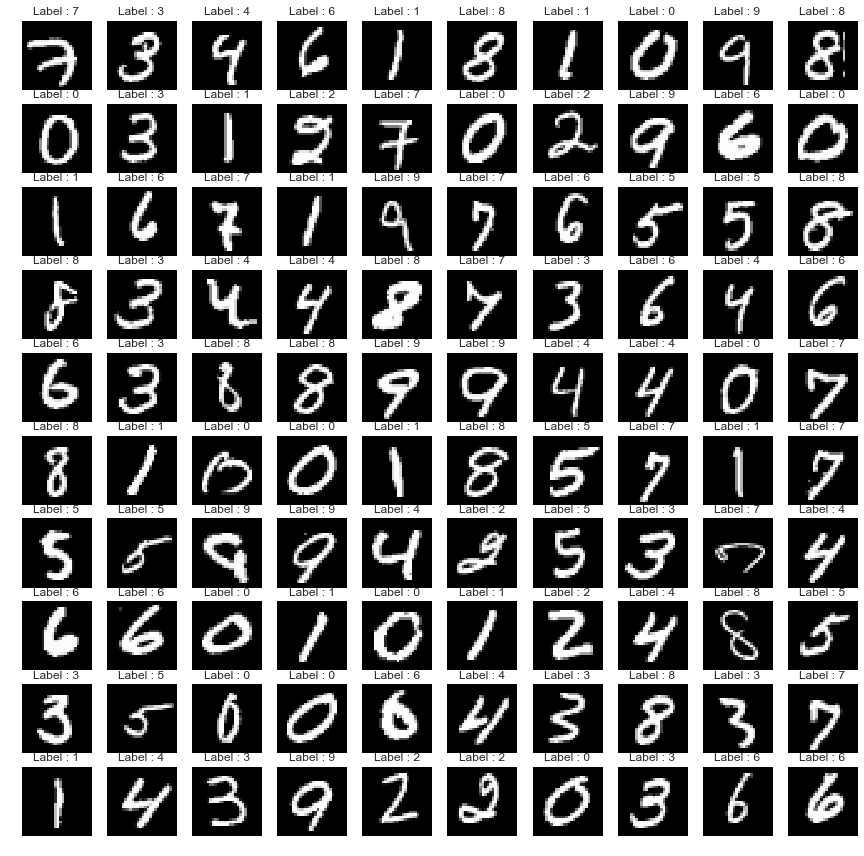

In [7]:
# show small amount of data
fig=plt.figure(figsize=(15, 15))
columns = 10 ; rows = 10
for i in range(1, columns*rows +1):
    fig.add_subplot(rows, columns, i)
    plt.imshow(np.squeeze(train_batch[i-1]),cmap='gray')
    plt.axis('off')
    plt.title("Label : "+str(np.argmax(train_label[i-1])))
plt.show()

In [221]:
# import all of the layers
def tf_elu(x):
    """ Exponential Linear Unit based on the ICCV 2015 paper
    https://arxiv.org/pdf/1511.07289.pdf

    Parameters
    ----------
    x : float
        The floating point number that is going to be applied to the ELU activation.

    Returns
    -------
    float
        Data with the same dimensions as the input after ELU

    """
    return tf.nn.elu(x)
def d_tf_elu(x):
    """Derivative of the Exponential Linear Unit base on the ICCV 2015 paper
    https://arxiv.org/pdf/1511.07289.pdf

    Parameters
    ----------
    x : type
        Description of parameter `x`.

    Returns
    -------
    type
        Description of returned object.

    """

    return tf.cast(tf.greater(x,0),tf.float32)  + (tf_elu(tf.cast(tf.less_equal(x,0),tf.float32) * x) + 1.0)

def tf_identiy(x)  : return x
def d_tf_identiy(x): return tf.ones_like(x,dtype=tf.float32)

def tf_relu(x):   return tf.nn.relu(x)
def d_tf_relu(x): return tf.cast(tf.greater(x,0.0),tf.float32)

def tf_lrelu(x): return tf.nn.leaky_relu(x,alpha=0.2)
def d_tf_lrelu(x): return tf.cast(tf.greater(x,0),tf.float32) + tf.cast(tf.less_equal(x,0),tf.float32) * 0.2

def tf_tanh(x): return tf.nn.tanh(x)
def d_tf_tanh(x): return 1 - tf_tanh(x) ** 2

def tf_sigmoid(x):   return tf.nn.sigmoid(x)
def d_tf_sigmoid(x): return tf_sigmoid(x) * (1.0-tf_sigmoid(x))

def tf_atan(x): return tf.atan(x)
def d_tf_atan(x): return 1.0/(1.0 + x**2)

def tf_softmax(x): return tf.nn.softmax(x)
def softabs(x): return tf.sqrt(x ** 2 + 1e-20)

def tf_logcosh(x): return tf.log(tf.cosh(x))
def d_tf_logcosh(x): return tf.tanh(x)

class FNN():

    def __init__(self,inc,outc,stddev=None,act=tf_elu,d_act=d_tf_elu,which_reg=0,init_x=False):
        if init_x:
            interval = np.sqrt(6.0 / (inc + outc + 1.0))
            self.w = tf.Variable(tf.random_uniform(shape=(inc, outc),minval=-interval,maxval=interval,dtype=tf.float32,seed=2))
            self.b = tf.Variable(tf.zeros(shape=[outc],dtype=tf.float32))
        else:
            self.w = tf.Variable(tf.random_normal([inc,outc],stddev=stddev,seed=2,dtype=tf.float32))
            self.b = tf.Variable(tf.zeros([outc],dtype=tf.float32))

        self.m,  self.v   = tf.Variable(tf.zeros_like(self.w)),tf.Variable(tf.zeros_like(self.w))
        self.m_b,self.v_b = tf.Variable(tf.zeros_like(self.b)),tf.Variable(tf.zeros_like(self.b))
        self.act,self.d_act = act,d_act
        self.which_reg = which_reg

    def getw(self): return self.w

    def feedforward(self,input=None):
        self.input  = input
        self.layer  = tf.matmul(input,self.w) + self.b
        self.layerA = self.act(self.layer)
        return self.layerA

    def backprop(self,gradient=None,learning_rate=None):
        grad_part_1 = gradient
        grad_part_2 = self.d_act(self.layer)
        grad_part_3 = self.input

        grad_middle = grad_part_1 * grad_part_2
        grad  = tf.matmul(tf.transpose(grad_part_3),grad_middle)/batch_size
        grad_b= tf.reduce_mean(grad_middle,0)/batch_size
        grad_pass = tf.matmul(grad_middle,tf.transpose(self.w))

        update_w = []
        update_w.append(tf.assign( self.m,self.m*beta1 + (1-beta1) * (grad)   ))
        update_w.append(tf.assign( self.v,self.v*beta2 + (1-beta2) * (grad ** 2)   ))
        m_hat = self.m / (1.-beta1)
        v_hat = self.v / (1.-beta2)
        adam_middle  = m_hat     *  learning_rate/(tf.sqrt(v_hat) + adam_e)
        update_w.append(tf.assign(self.w,tf.subtract(self.w,adam_middle )))

        update_w.append(tf.assign(self.m_b,self.m_b*beta1 + (1-beta1) * (grad_b)   ))
        update_w.append(tf.assign(self.v_b,self.v_b*beta2 + (1-beta2) * (grad_b ** 2)   ))
        m_hat_b = self.m_b / (1-beta1)
        v_hat_b = self.v_b / (1-beta2)
        adam_middle_b = m_hat_b *  learning_rate/(tf.sqrt(v_hat_b) + adam_e)
        update_w.append(tf.assign(self.b,tf.subtract(self.b,adam_middle_b ))) 
        
        return grad_pass,update_w

class CNN():

    def __init__(self,k,inc,out,stddev=0.005,which_reg=0,act=tf_elu,d_act=d_tf_elu,residual=False):
        self.w = tf.Variable(tf.random_normal([k,k,inc,out],stddev=stddev,seed=2,dtype=tf.float32))
        self.m,self.v = tf.Variable(tf.zeros_like(self.w)),tf.Variable(tf.zeros_like(self.w))
        self.act,self.d_act = act,d_act
        self.which_reg = which_reg
        self.residual = residual

    def getw(self): return self.w

    def feedforward(self,input,stride=1,padding='VALID'):
        self.input  = input
        if self.residual: 
            self.layer  = tf.nn.conv2d(input,self.w,strides=[1,stride,stride,1],padding='SAME')
            self.layerA = self.act(self.layer) + input
        else:
            self.layer  = tf.nn.conv2d(input,self.w,strides=[1,stride,stride,1],padding=padding)
            self.layerA = self.act(self.layer)
        return self.layerA

    def backprop(self,gradient,stride=1,padding='VALID'):
        grad_part_1 = gradient
        grad_part_2 = self.d_act(self.layer)
        grad_part_3 = self.input

        grad_middle = grad_part_1 * grad_part_2

        if self.residual: 
            grad = tf.nn.conv2d_backprop_filter(input = grad_part_3,filter_sizes = self.w.shape,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding='SAME'
            ) / batch_size
            
            grad_pass = tf.nn.conv2d_backprop_input(input_sizes = [batch_size] + list(grad_part_3.shape[1:]),filter= self.w,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding='SAME'
            ) + gradient
        else: 
            grad = tf.nn.conv2d_backprop_filter(input = grad_part_3,filter_sizes = self.w.shape,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding=padding
            ) / batch_size
        
            grad_pass = tf.nn.conv2d_backprop_input(input_sizes = [batch_size] + list(grad_part_3.shape[1:]),filter= self.w,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding=padding
            )

        # === Reg ===        
        if self.which_reg == 0:
            grad = grad

        if self.which_reg == 0.5:
            grad = grad + lamda * (tf.sqrt(tf.abs(self.w))) * (1.0/tf.sqrt(tf.abs(self.w)+ 10e-5)) * tf.sign(self.w)

        if self.which_reg == 1:
            grad = grad + lamda * tf.sign(self.w)

        if self.which_reg == 1.5:
            grad = grad + lamda * 1.0/(tf.sqrt(tf.square(self.w) + 10e-5)) * self.w

        if self.which_reg == 2:
            grad = grad + lamda * (1.0/tf.sqrt(tf.square(tf.abs(self.w))+ 10e-5)) * tf.abs(self.w) * tf.sign(self.w)

        if self.which_reg == 2.5:
            grad = grad + lamda * 2.0 * self.w

        if self.which_reg == 3:
            grad = grad + lamda * tf.pow(tf.pow(tf.abs(self.w),3)+ 10e-5,-0.66) * tf.pow(tf.abs(self.w),2) * tf.sign(self.w)

        if self.which_reg == 4:
            grad = grad + lamda * tf.pow(tf.pow(tf.abs(self.w),4)+ 10e-5,-0.75) * tf.pow(tf.abs(self.w),3) * tf.sign(self.w)

        update_w = []
        update_w.append(tf.assign( self.m,self.m*beta1 + (1-beta1) * (grad)   ))
        update_w.append(tf.assign( self.v,self.v*beta2 + (1-beta2) * (grad ** 2)   ))
        m_hat = self.m / (1-beta1)
        v_hat = self.v / (1-beta2)
        adam_middel = learning_rate/(tf.sqrt(v_hat) + adam_e)
        update_w.append(tf.assign(self.w,tf.subtract(self.w,tf.multiply(adam_middel,m_hat)  )))
        return grad_pass,update_w

In [222]:
# hyper class
num_epoch = 101; batch_size = 100; print_size = 1; lamda = 0.0
beta1,beta2,adam_e = 0.9,0.999,1e-8; eps = 1e-10

e1 = FNN(784,1000,       stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
e2 = FNN(1000,1000,      stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
e3 = FNN(1000,2,         stddev=0.005,which_reg=0,act=tf_atan,d_act=d_tf_atan)

d1 = FNN(2,1000,         stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
d2 = FNN(1000,1000,      stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
d3 = FNN(1000,784,       stddev=0.005,which_reg=0,act=tf_sigmoid,d_act=d_tf_sigmoid)

# discrim1 = FNN(2,1000   ,stddev=0.005,which_reg=0.0,act=tf_relu,d_act=d_tf_relu,keeprate=1.0)
# discrim2 = FNN(1000,1000,stddev=0.005,which_reg=0.0,act=tf_relu,d_act=d_tf_relu,keeprate=1.0)
# discrim3 = FNN(1000,1   ,stddev=0.005,which_reg=0.0,act=tf_sigmoid,d_act=d_tf_sigmoid,keeprate=1.0)

In [224]:
# 1. Update the encoding and decoding
x0  = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr0 = tf.placeholder(shape=[],dtype=tf.float32)

elayer1 = e1.feedforward(x0)
elayer2 = e2.feedforward(elayer1)
elayer3 = e3.feedforward(elayer2)

dlayer1 = d1.feedforward(elayer3)
dlayer2 = d2.feedforward(dlayer1)
dlayer3 = d3.feedforward(dlayer2)

recon_cost = -tf.reduce_mean(x0*tf.log(dlayer3+10e-10)+ (1.0-x0)*tf.log(1.0-dlayer3+10e-10))
# auto_train = tf.train.AdamOptimizer(learning_rate=lr0).minimize(recon_cost)
recon_ = (-(x0/(dlayer3+10e-10)) + (1.0-x0)/(1.0-dlayer3+10e-10))/(batch_size)

def norm_vec(x):
    return ((x-tf.reduce_min(x,1)[:,None]) /(tf.reduce_max(x,1)-tf.reduce_min(x,1))[:,None]) *\
           (0.00005 + 0.00005) - 0.00005

dgrad3,dgrad3_up = d3.backprop(norm_vec(recon_)+recon_,learning_rate=lr0)
dgrad2,dgrad2_up = d2.backprop(norm_vec(dgrad3)+dgrad3,learning_rate=lr0)
dgrad1,dgrad1_up = d1.backprop(norm_vec(dgrad2)+dgrad2,learning_rate=lr0)

egrad3,egrad3_up = e3.backprop(norm_vec(dgrad1)+dgrad1,learning_rate=lr0)
egrad2,egrad2_up = e2.backprop(norm_vec(egrad3)+egrad3,learning_rate=lr0)
egrad1,egrad1_up = e1.backprop(norm_vec(egrad2)+egrad2,learning_rate=lr0)

grad0_update = dgrad3_up + dgrad2_up + dgrad1_up + egrad3_up + egrad2_up + egrad1_up

# # https://stats.stackexchange.com/questions/281162/scale-a-number-between-a-range 00005
# def norm_vec(x,aimed_max,aimed_min):
#     return ((x-tf.reduce_min(x,1)[:,None]) /(tf.reduce_max(x,1)-tf.reduce_min(x,1))[:,None]) *\
#            (aimed_max - aimed_min) - aimed_min

# dgrad3,dgrad3_up = d3.backprop(norm_vec(recon_,0.00005,-0.00005)+recon_,learning_rate=lr0)
# dgrad2,dgrad2_up = d2.backprop(norm_vec(dgrad3,0.00005,-0.00005)+dgrad3,learning_rate=lr0)
# dgrad1,dgrad1_up = d1.backprop(norm_vec(dgrad2,0.00005,-0.00005)+dgrad2,learning_rate=lr0)

# egrad3,egrad3_up = e3.backprop(norm_vec(dgrad1,0.00005,-0.00005)+dgrad1,learning_rate=lr0)
# egrad2,egrad2_up = e2.backprop(norm_vec(egrad3,0.00005,-0.00005)+egrad3,learning_rate=lr0)
# egrad1,egrad1_up = e1.backprop(norm_vec(egrad2,0.00005,-0.00005)+egrad2,learning_rate=lr0)

# grad0_update = dgrad3_up + dgrad2_up + dgrad1_up + egrad3_up + egrad2_up + egrad1_up

 iter: 0 batch: 19900 recon cost: 0.24059593

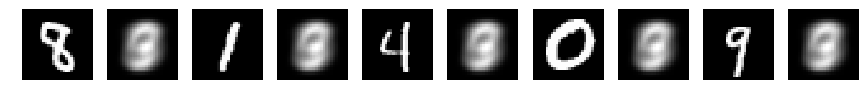

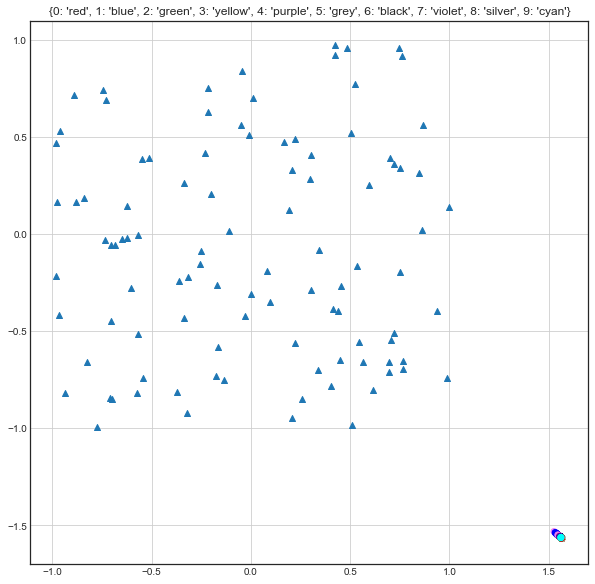

 iter: 1 batch: 19900 recon cost: 0.23917471

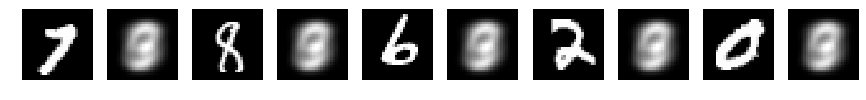

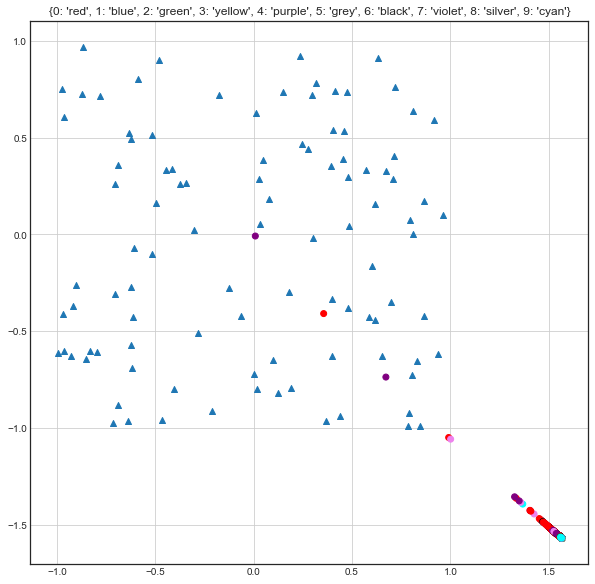

 iter: 2 batch: 19900 recon cost: 0.23933972

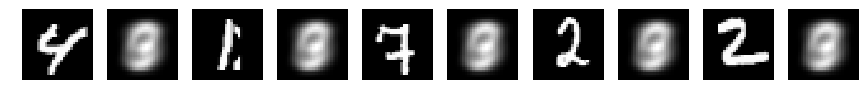

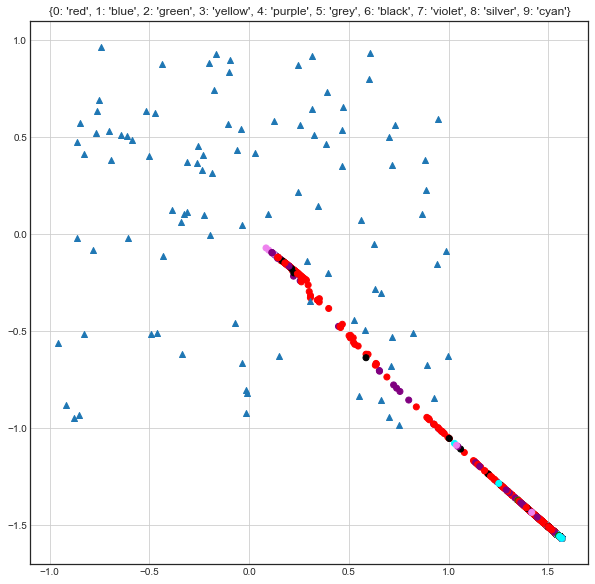

 iter: 3 batch: 19900 recon cost: 0.23783635

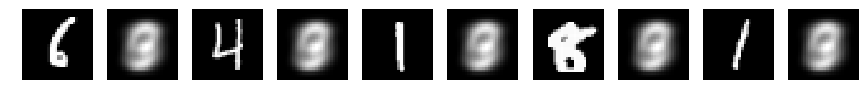

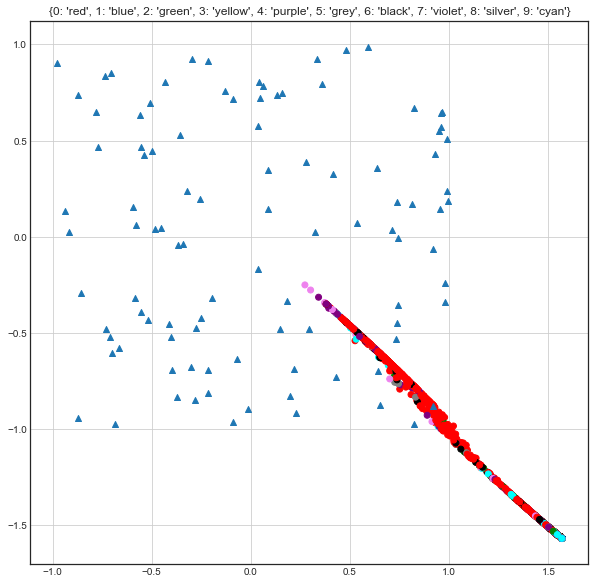

 iter: 4 batch: 19900 recon cost: 0.23690778

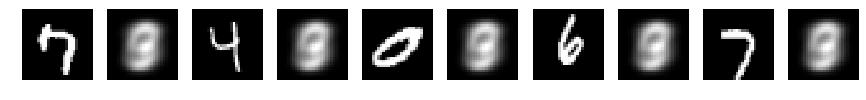

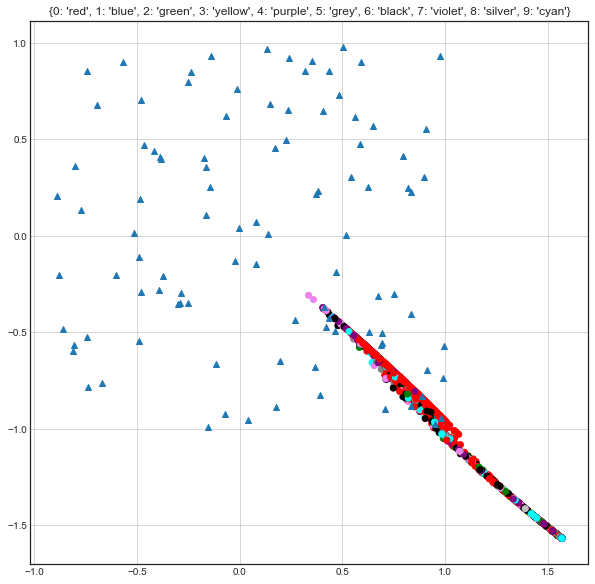

 iter: 5 batch: 19900 recon cost: 0.23637775

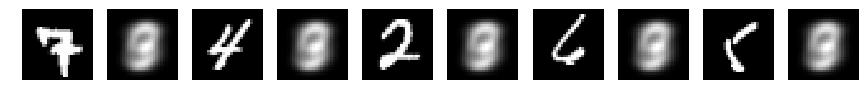

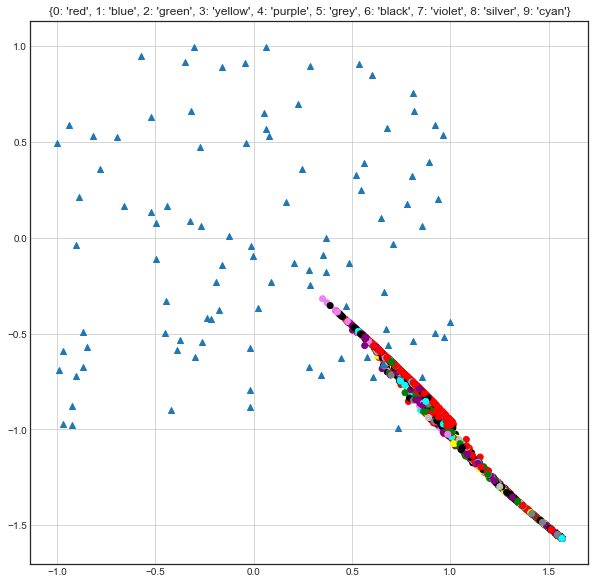

 iter: 6 batch: 19900 recon cost: 0.23592414

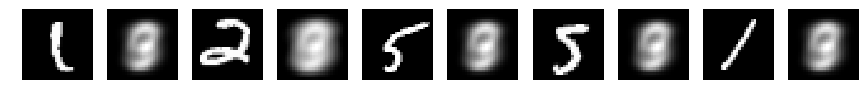

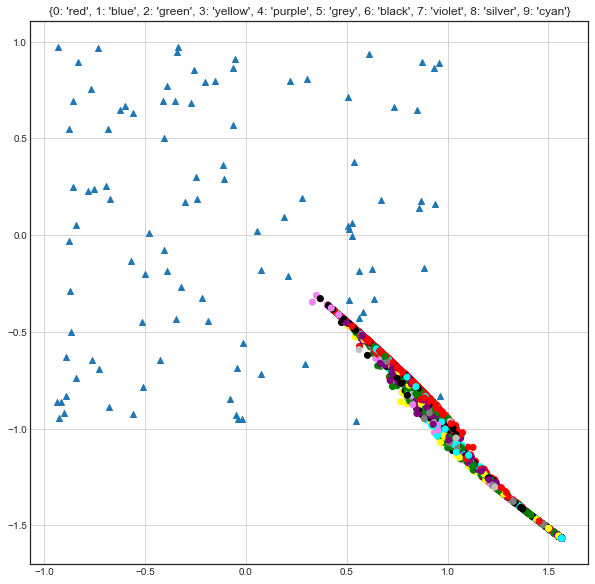

 iter: 7 batch: 19900 recon cost: 0.23324104

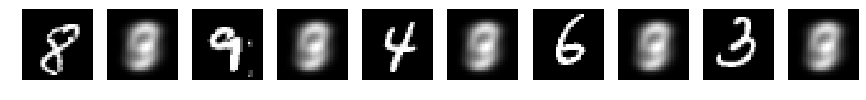

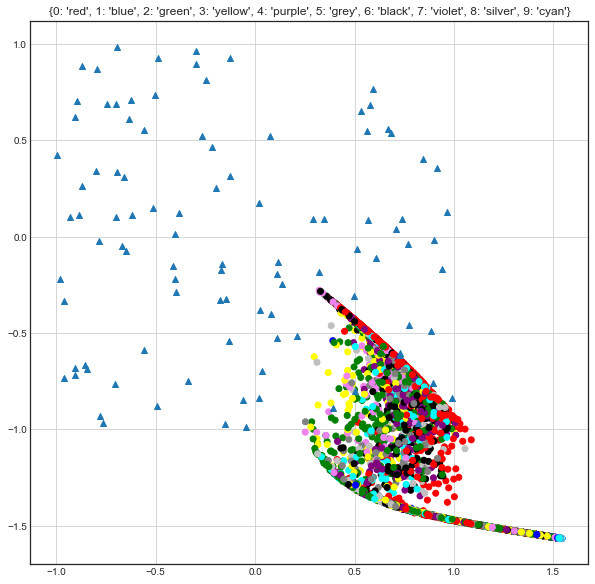

 iter: 8 batch: 19900 recon cost: 0.23086844

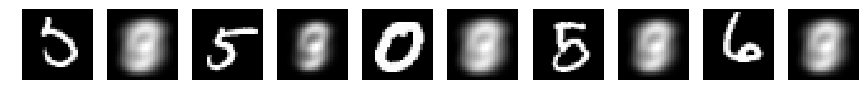

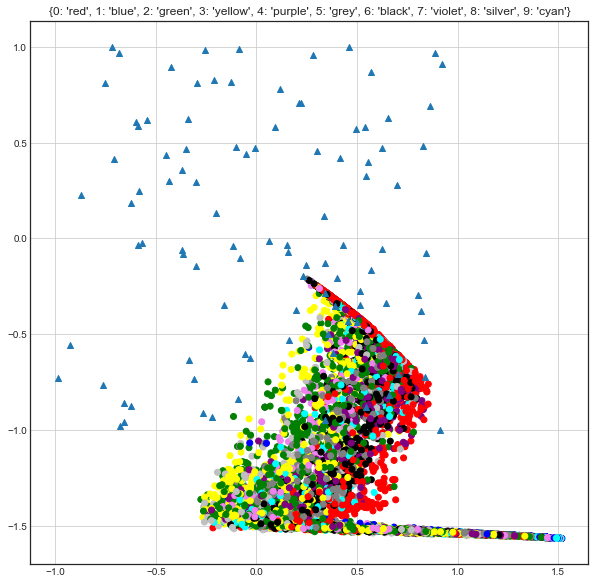

 iter: 9 batch: 19900 recon cost: 0.22868845

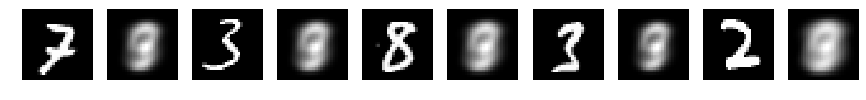

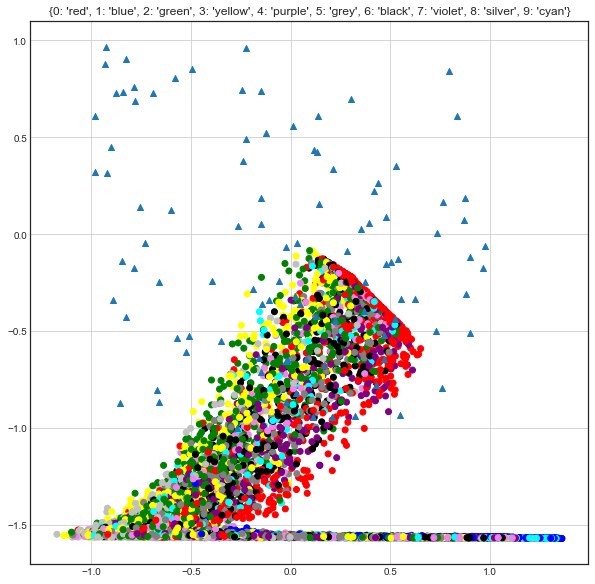

 iter: 10 batch: 19900 recon cost: 0.22697817

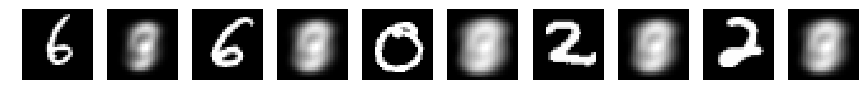

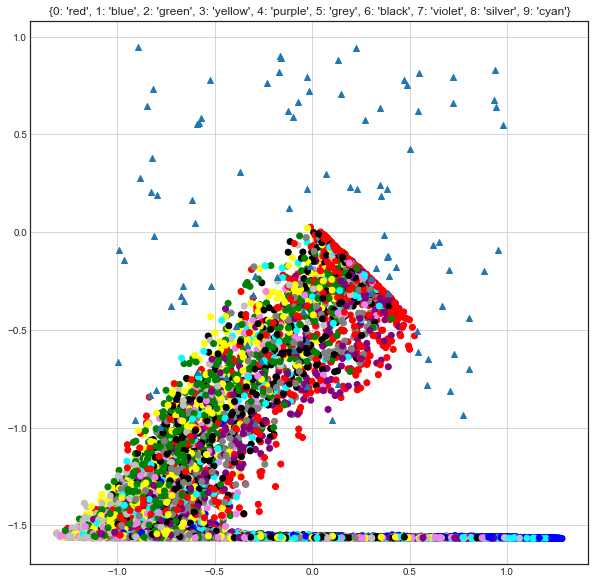

 iter: 11 batch: 19900 recon cost: 0.22262456

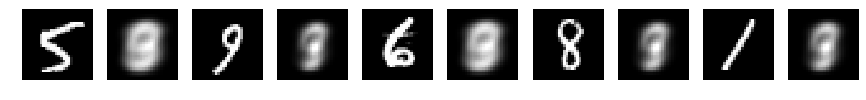

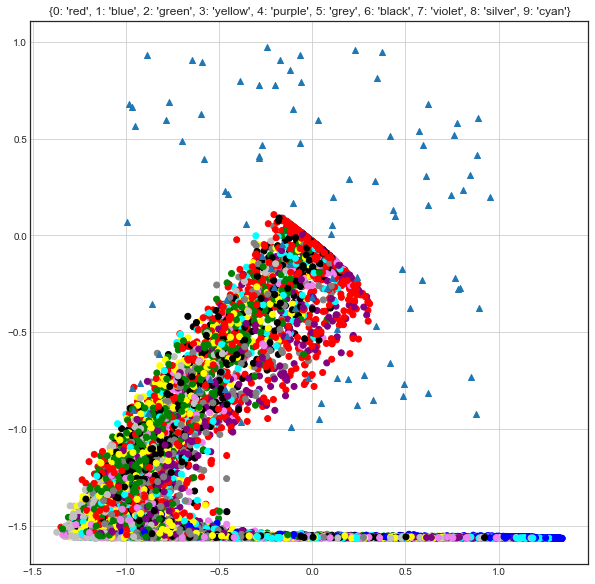

 iter: 12 batch: 19900 recon cost: 0.21683384

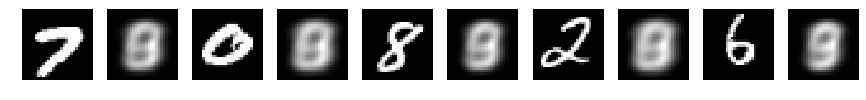

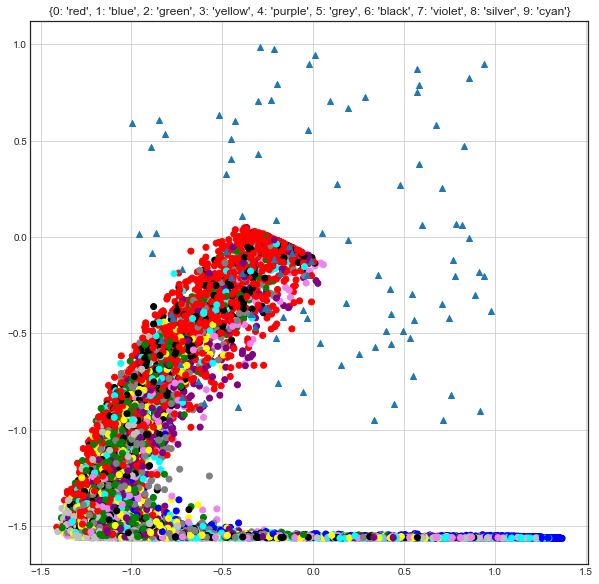

 iter: 13 batch: 19900 recon cost: 0.21404232

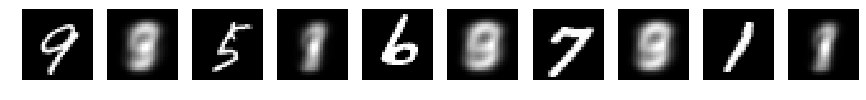

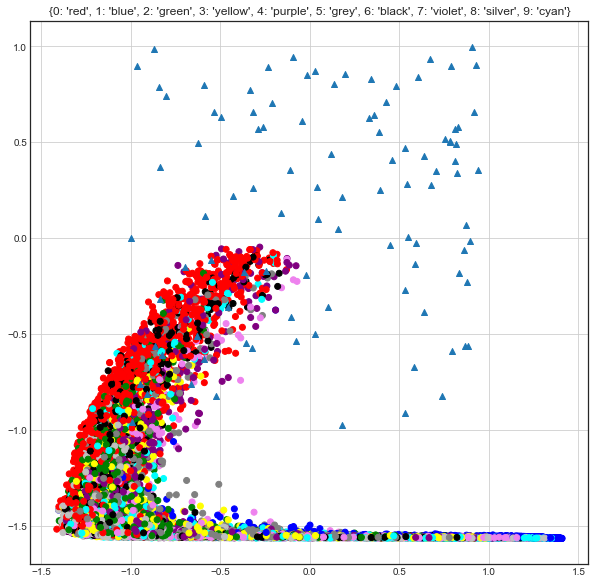

 iter: 14 batch: 19900 recon cost: 0.21179274

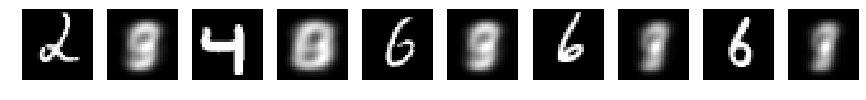

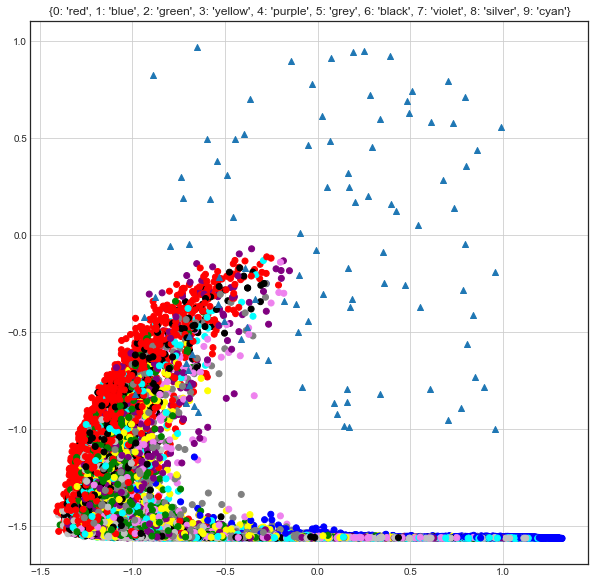

 iter: 15 batch: 19900 recon cost: 0.21133652

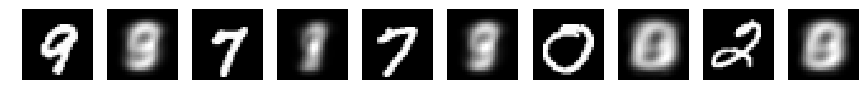

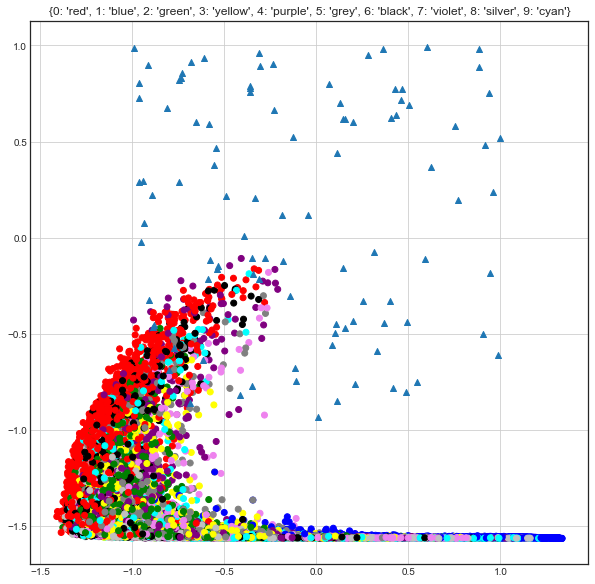

 iter: 16 batch: 19900 recon cost: 0.21100615

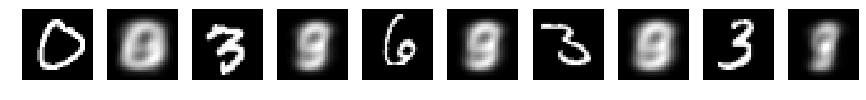

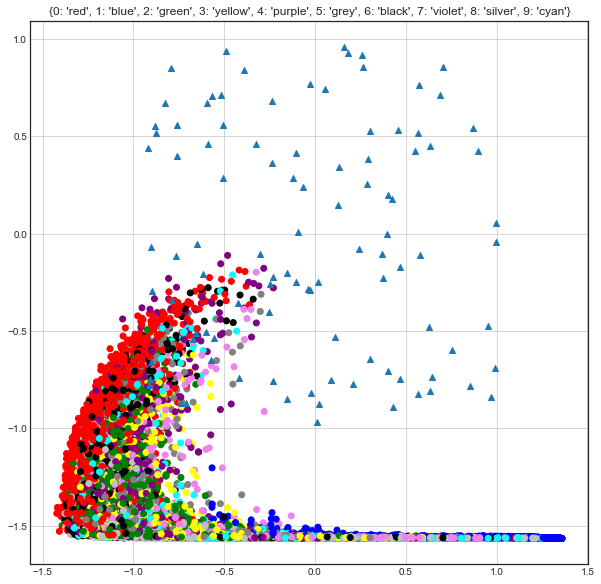

 iter: 17 batch: 19900 recon cost: 0.20986854

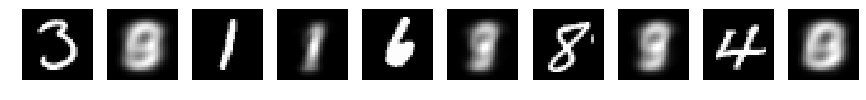

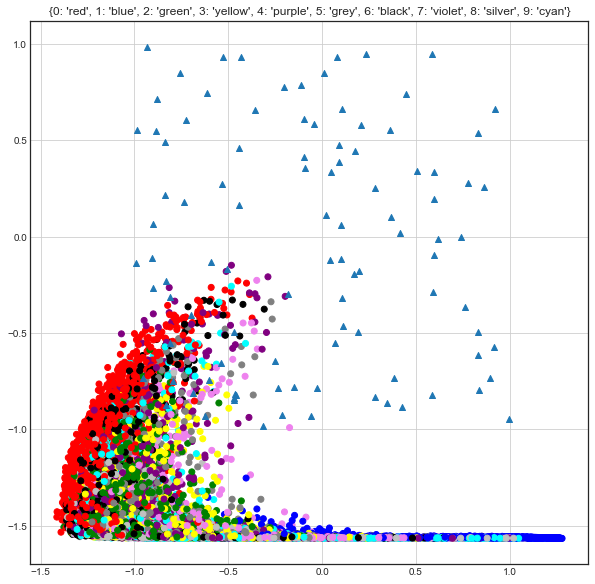

 iter: 18 batch: 19900 recon cost: 0.21074858

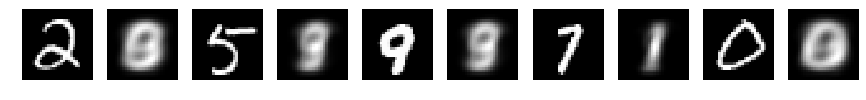

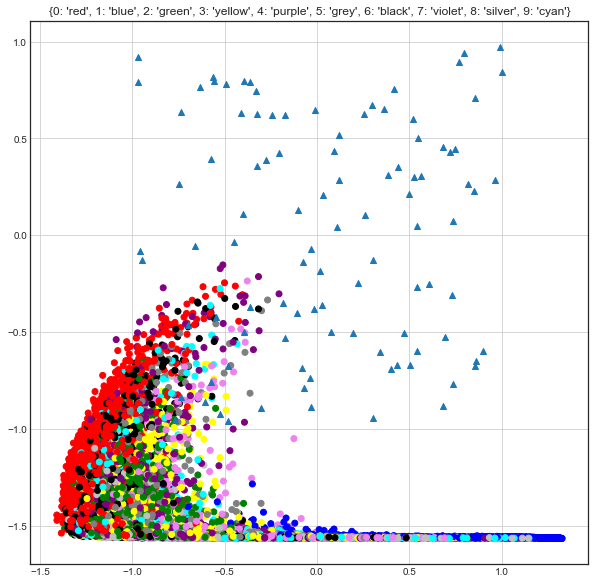

 iter: 19 batch: 19900 recon cost: 0.20926408

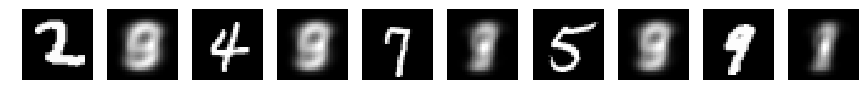

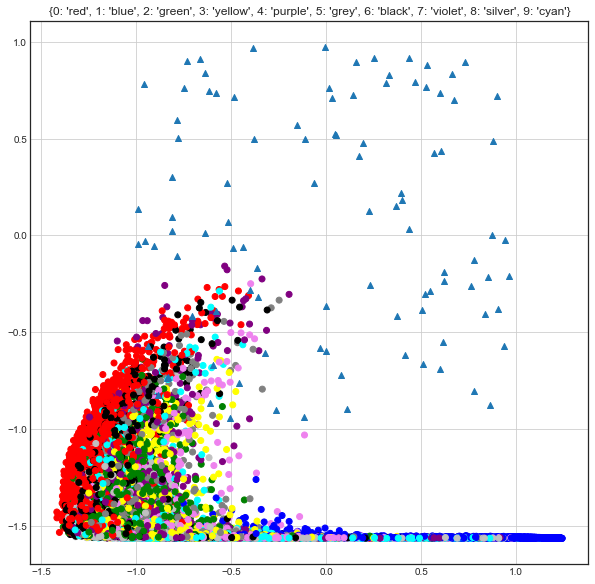

 iter: 20 batch: 19900 recon cost: 0.21011893

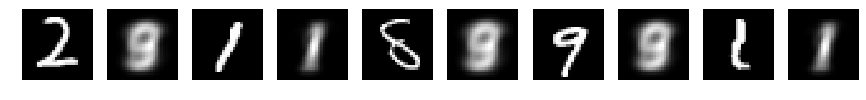

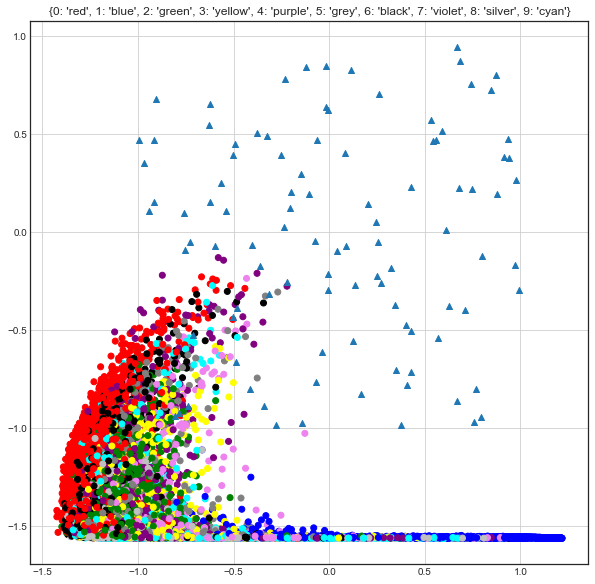

 iter: 21 batch: 19900 recon cost: 0.20885514

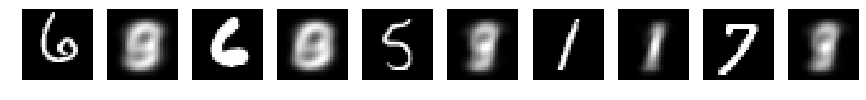

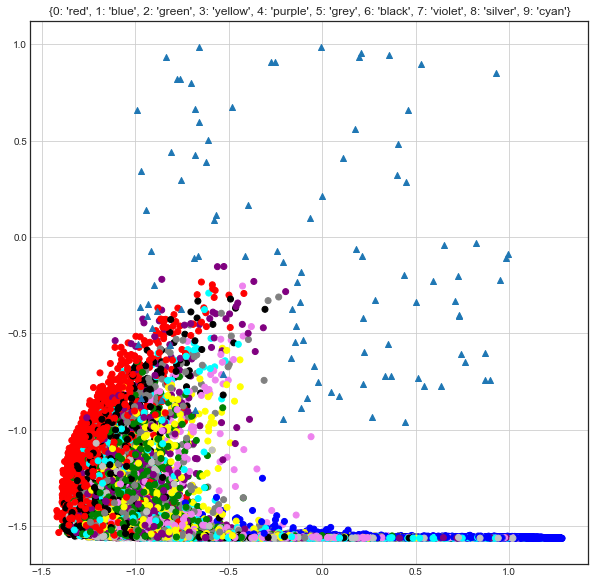

 iter: 22 batch: 19900 recon cost: 0.22098124

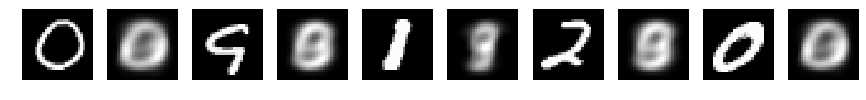

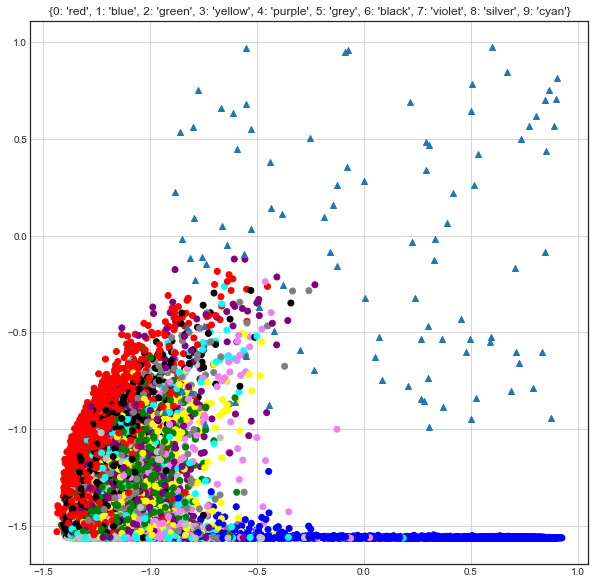

 iter: 23 batch: 19900 recon cost: 0.20833555

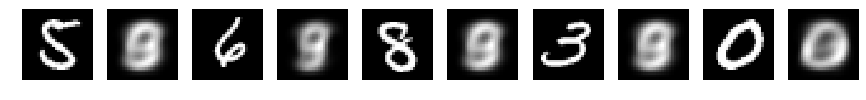

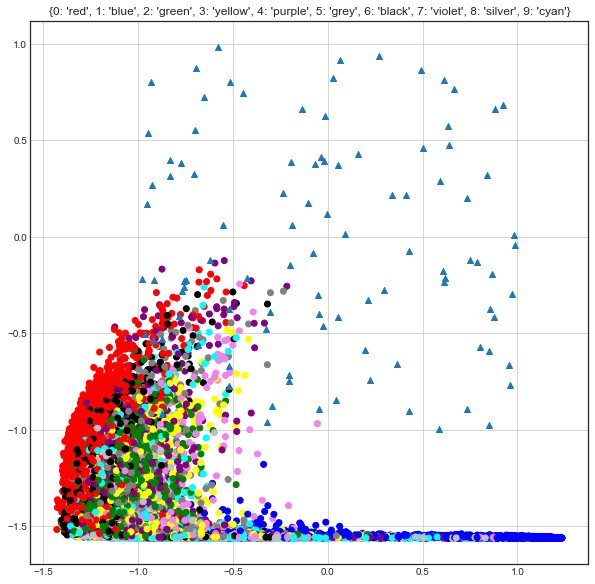

 iter: 24 batch: 19900 recon cost: 0.20838299

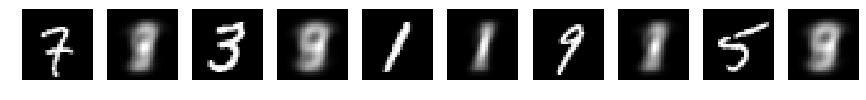

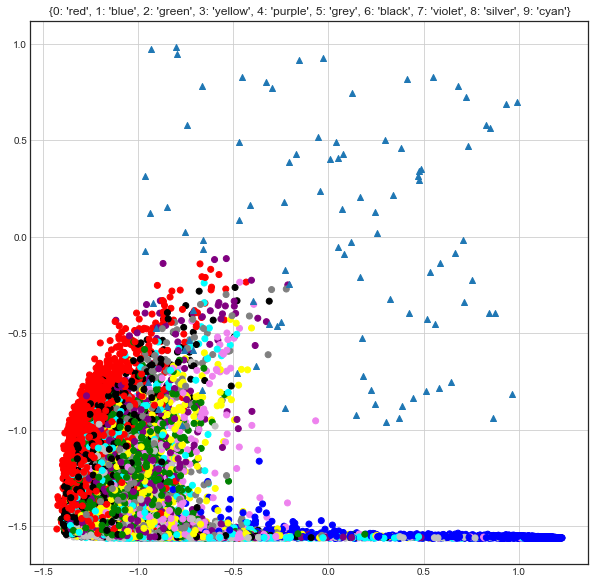

 iter: 25 batch: 19900 recon cost: 0.20878258

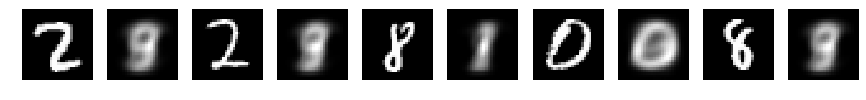

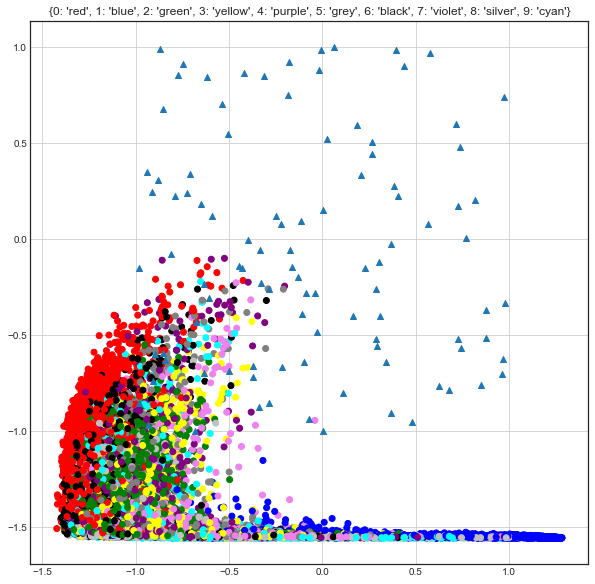

 iter: 26 batch: 19900 recon cost: 0.20820545

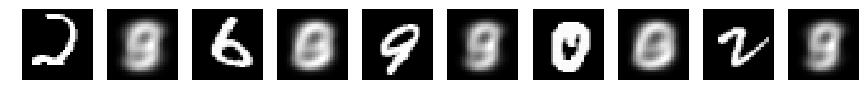

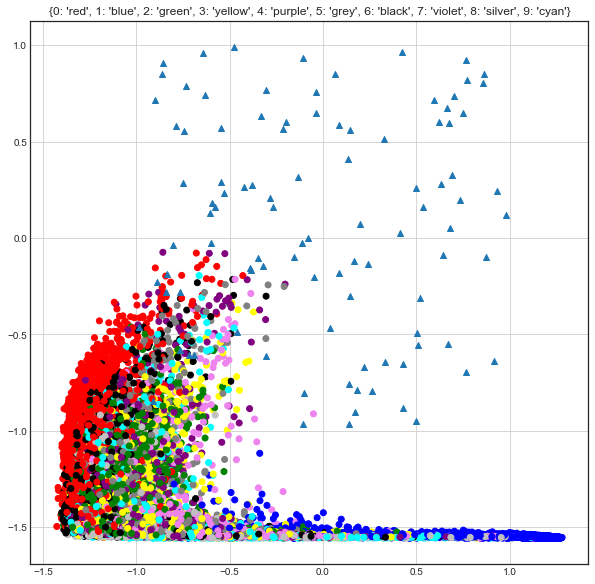

 iter: 27 batch: 19900 recon cost: 0.20741844

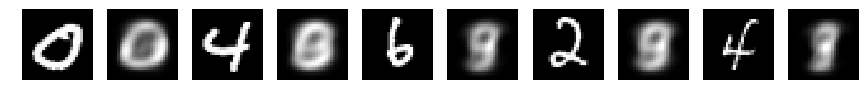

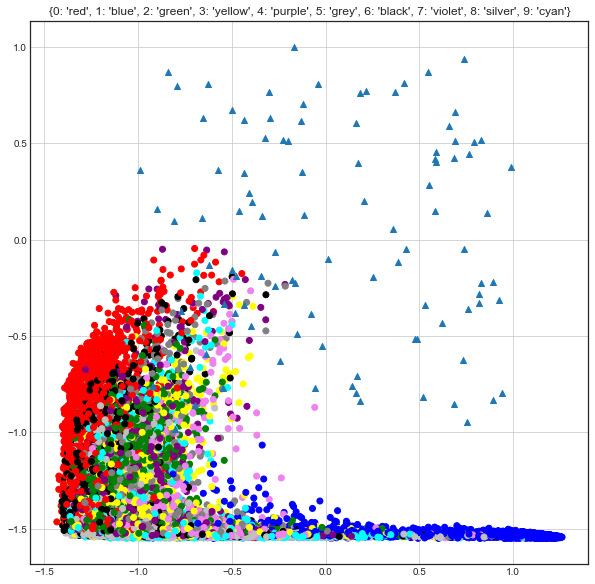

 iter: 28 batch: 19900 recon cost: 0.20726186

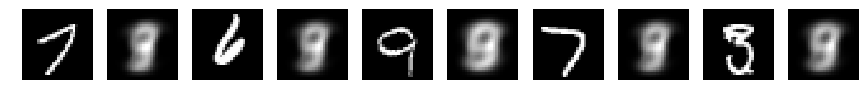

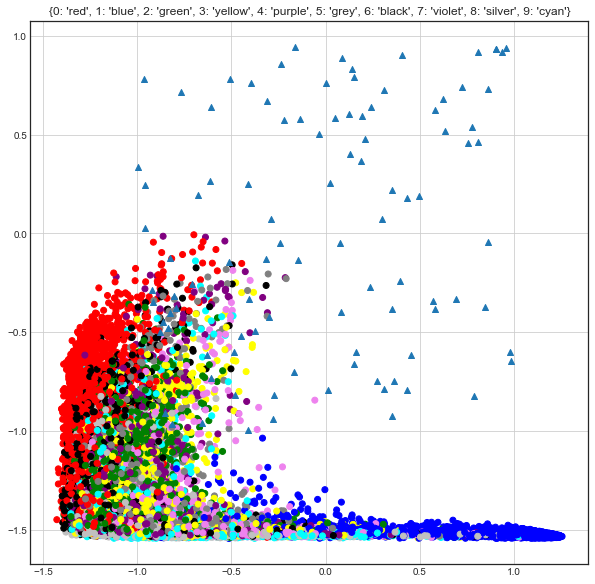

 iter: 29 batch: 19900 recon cost: 0.20977758

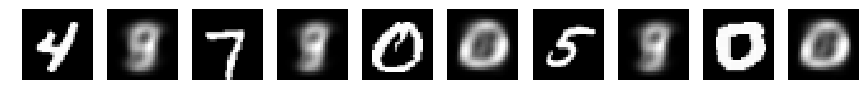

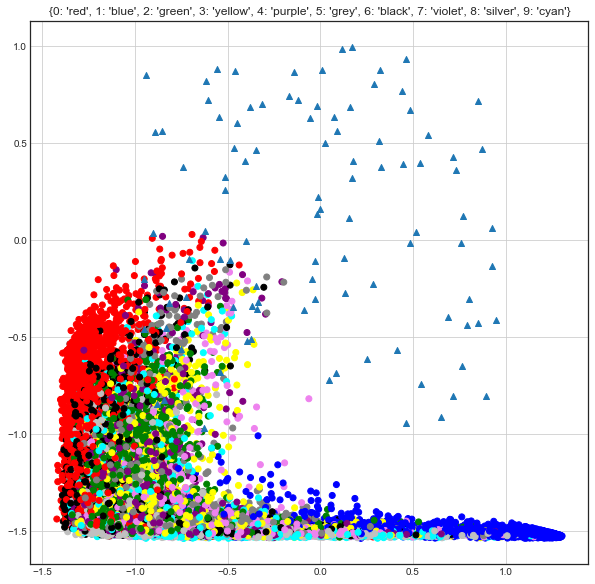

 iter: 30 batch: 19900 recon cost: 0.20725608

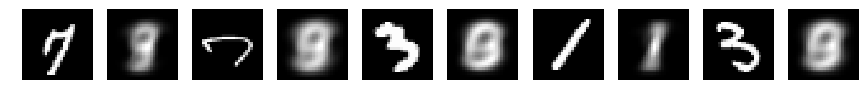

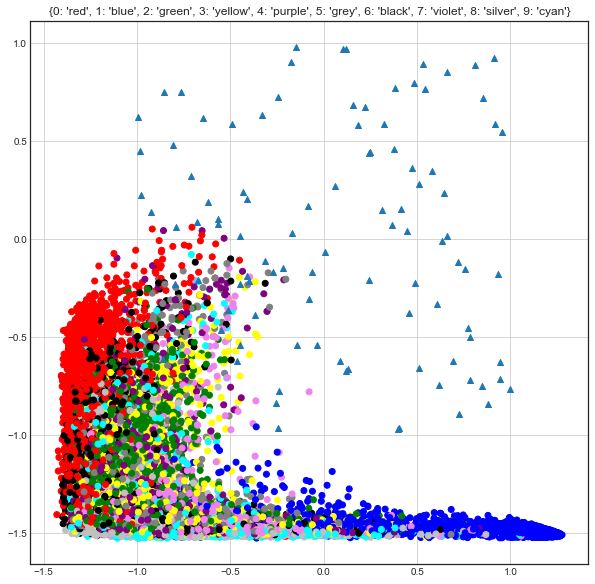

 iter: 31 batch: 19900 recon cost: 0.20681159

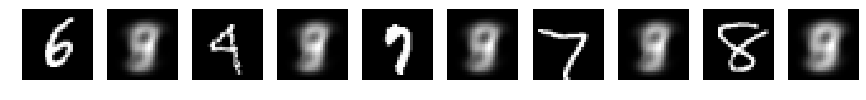

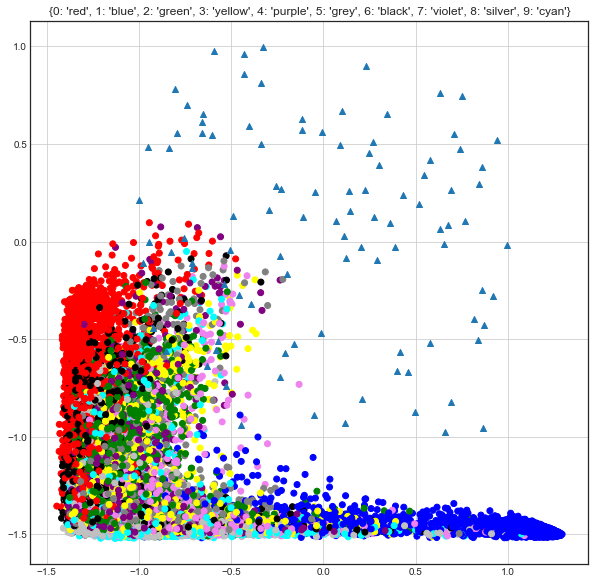

 iter: 32 batch: 19900 recon cost: 0.20699416

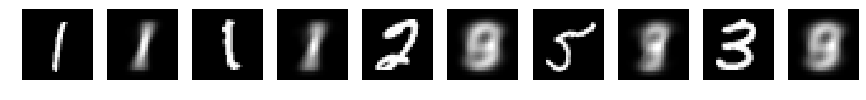

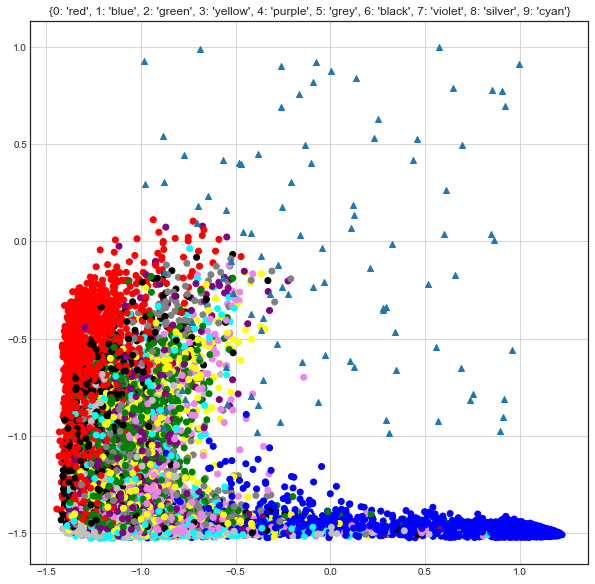

 iter: 33 batch: 19900 recon cost: 0.20695964

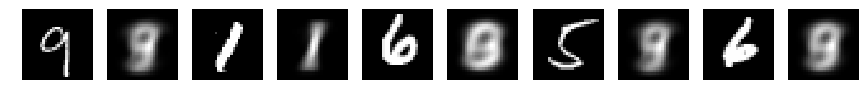

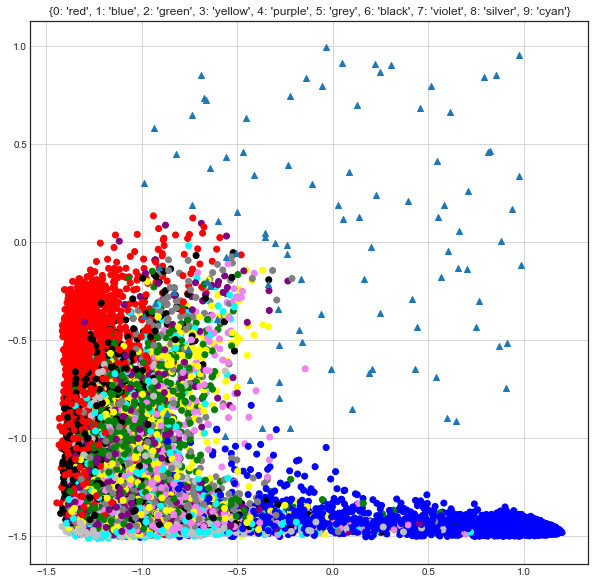

 iter: 34 batch: 19900 recon cost: 0.20620494

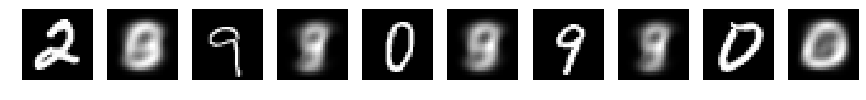

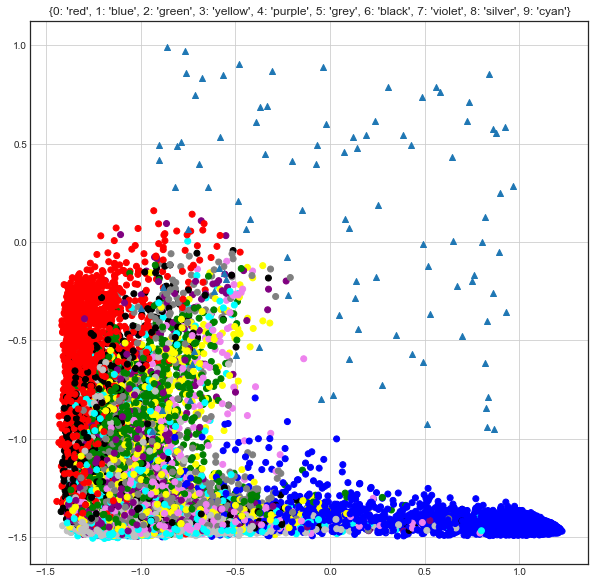

 iter: 35 batch: 19900 recon cost: 0.20593673

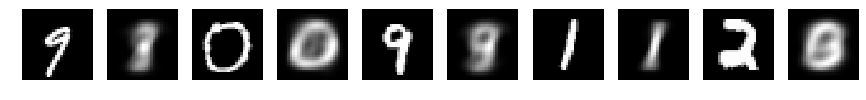

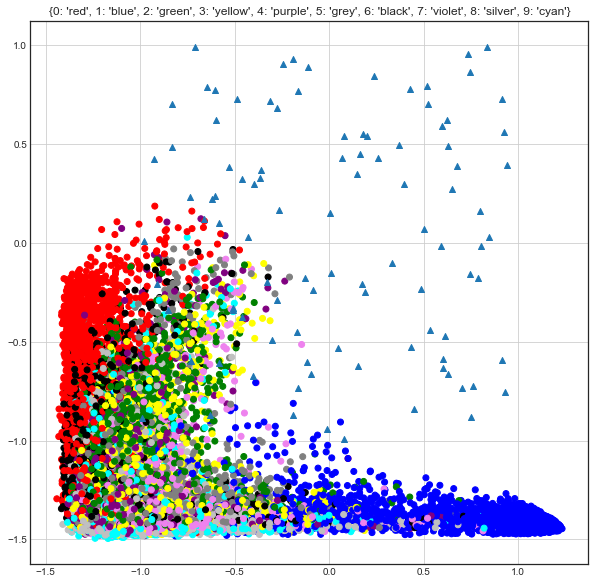

 iter: 36 batch: 19900 recon cost: 0.20582233

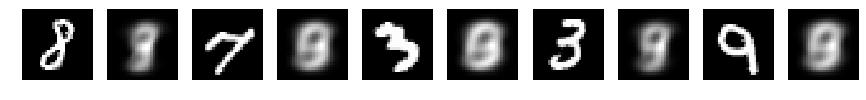

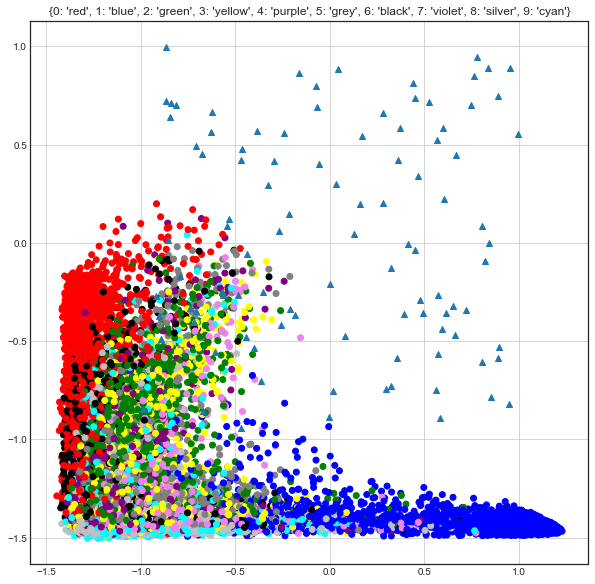

 iter: 37 batch: 19900 recon cost: 0.20570186

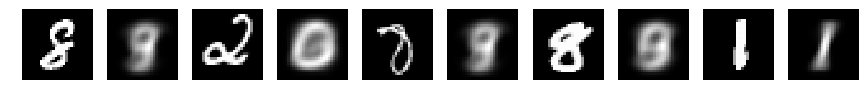

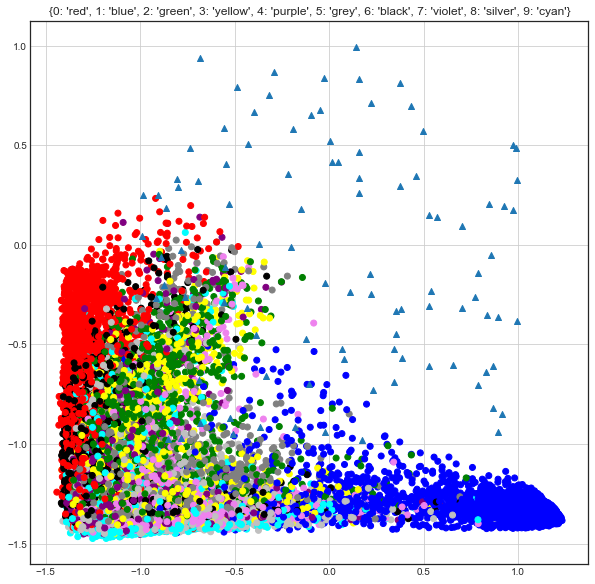

 iter: 38 batch: 19900 recon cost: 0.20539662

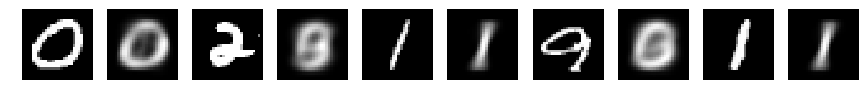

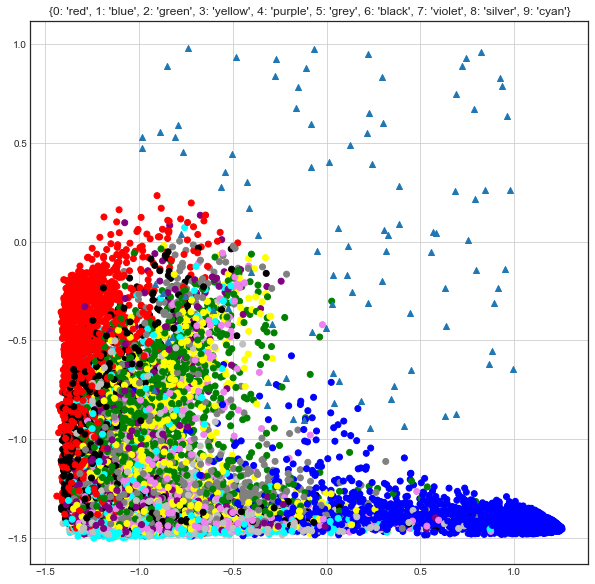

 iter: 39 batch: 19900 recon cost: 0.20534918

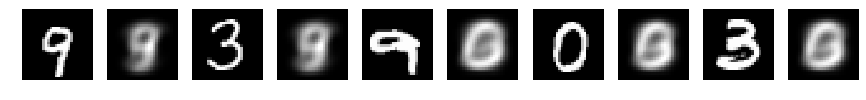

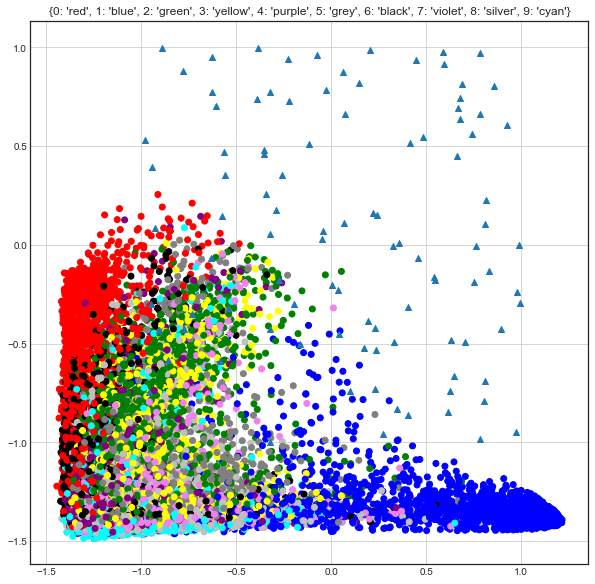

 iter: 40 batch: 19900 recon cost: 0.20520282

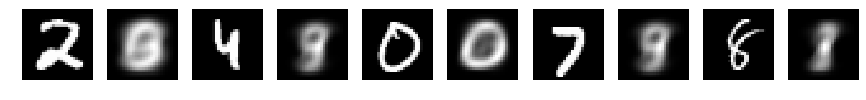

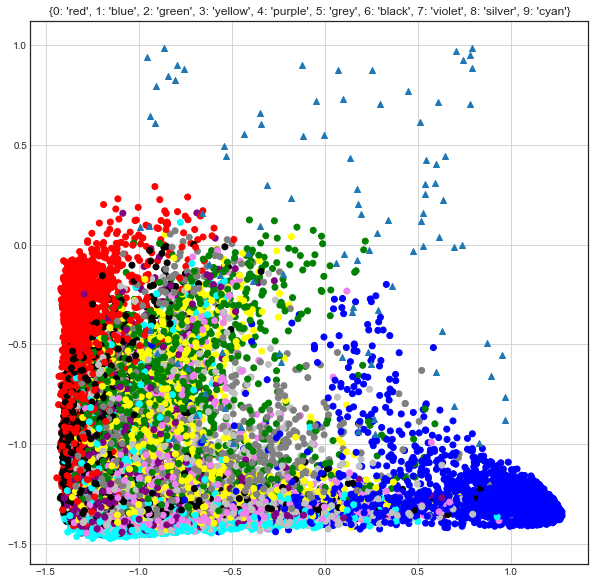

 iter: 41 batch: 19900 recon cost: 0.20453133

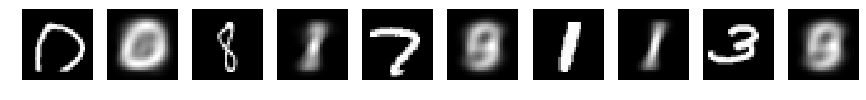

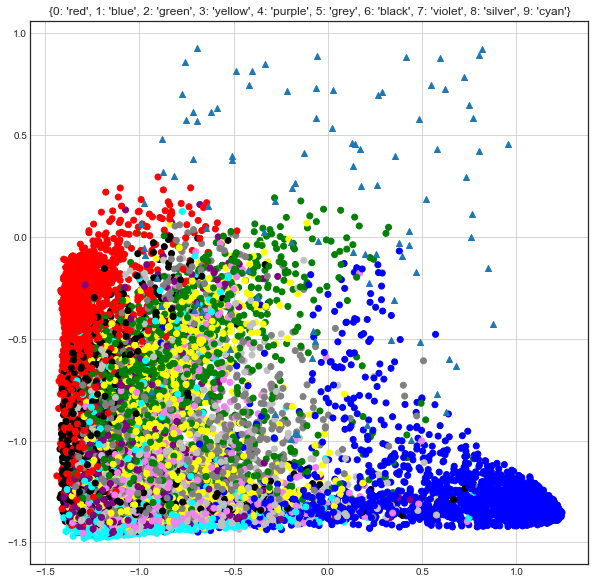

 iter: 42 batch: 19900 recon cost: 0.20436848

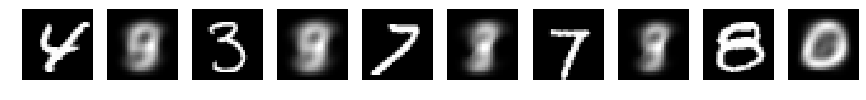

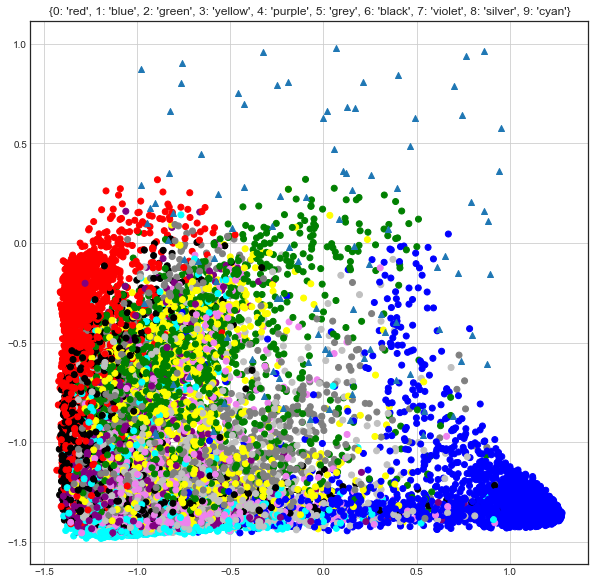

 iter: 43 batch: 19900 recon cost: 0.20498095

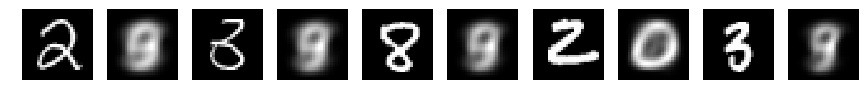

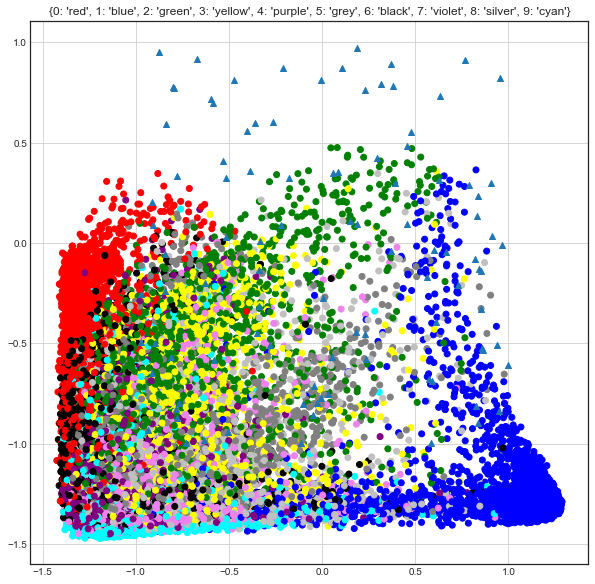

 iter: 44 batch: 19900 recon cost: 0.20443743

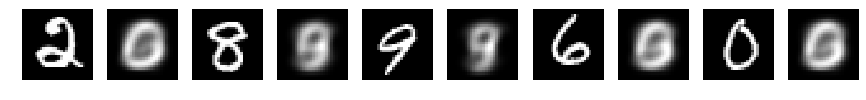

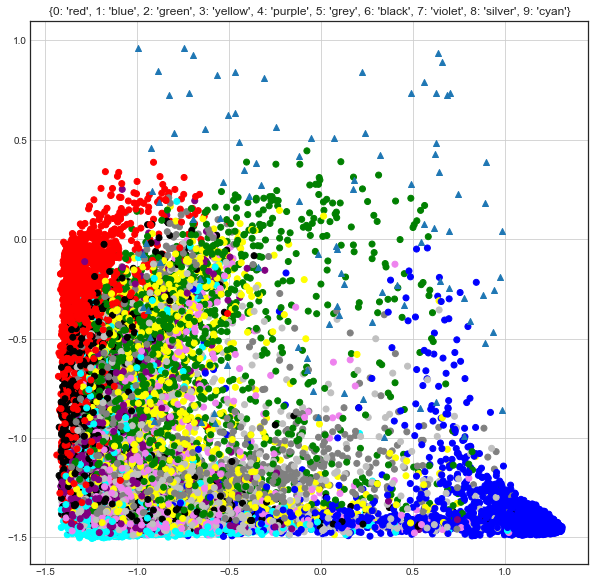

 iter: 45 batch: 19900 recon cost: 0.20450644

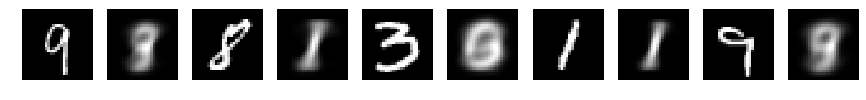

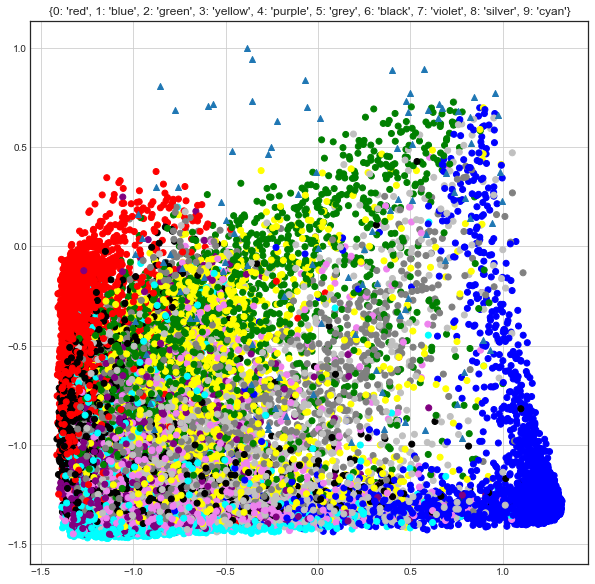

 iter: 46 batch: 19900 recon cost: 0.20368849

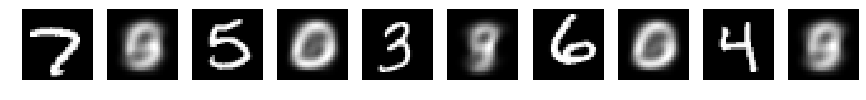

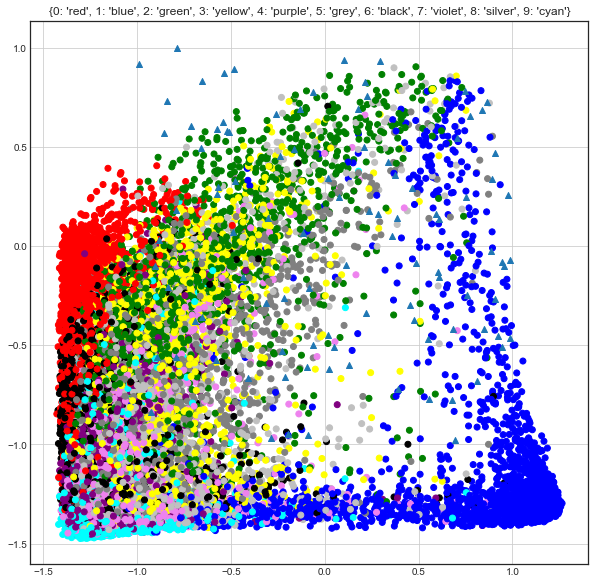

 iter: 47 batch: 19900 recon cost: 0.20100679

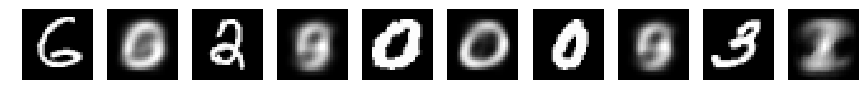

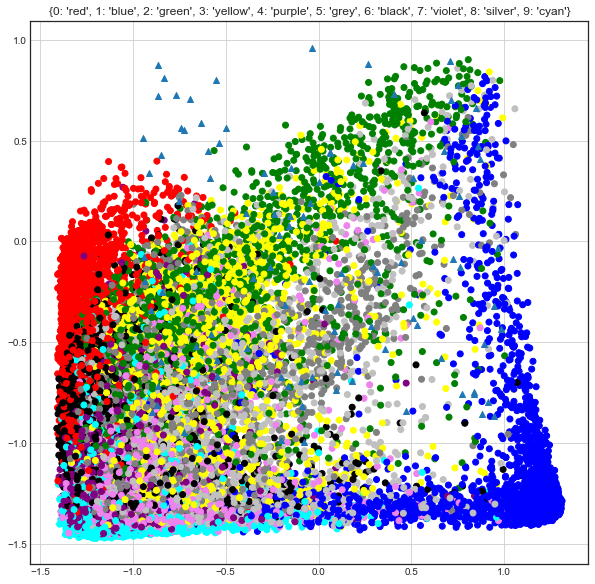

 iter: 48 batch: 19900 recon cost: 0.19924334

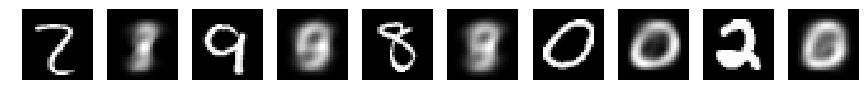

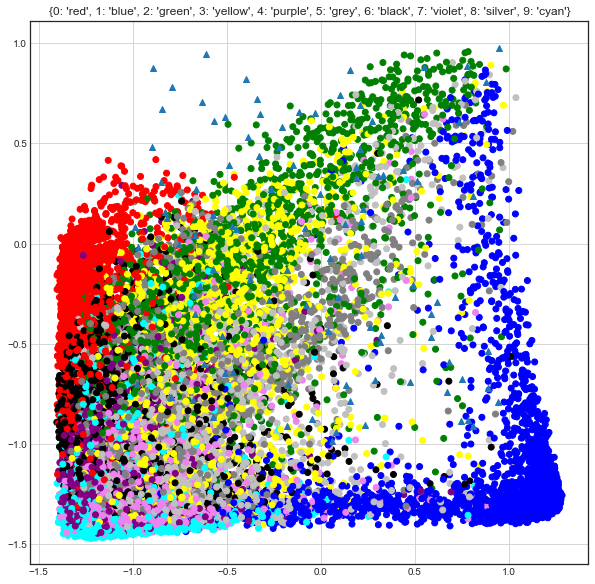

 iter: 49 batch: 19900 recon cost: 0.20223567

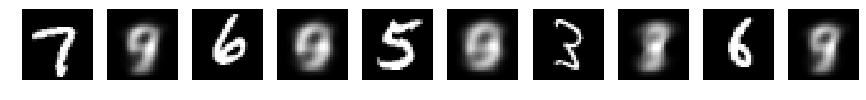

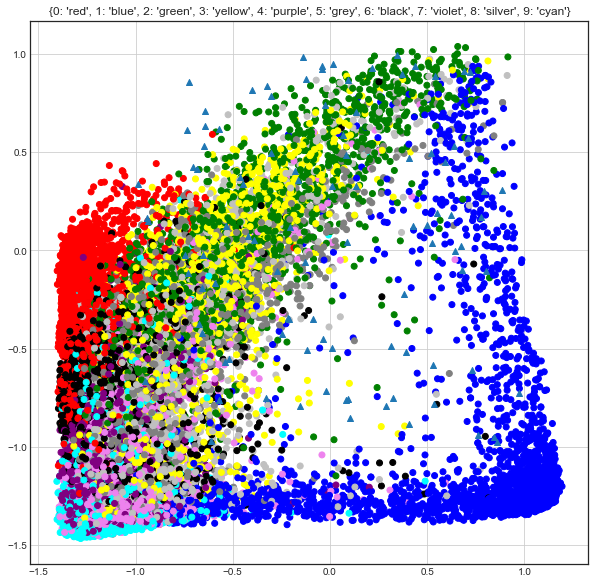

 iter: 50 batch: 19900 recon cost: 0.19656631

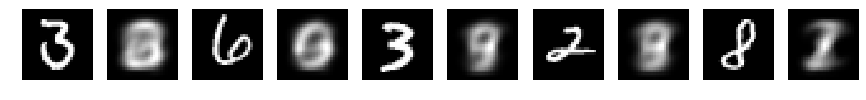

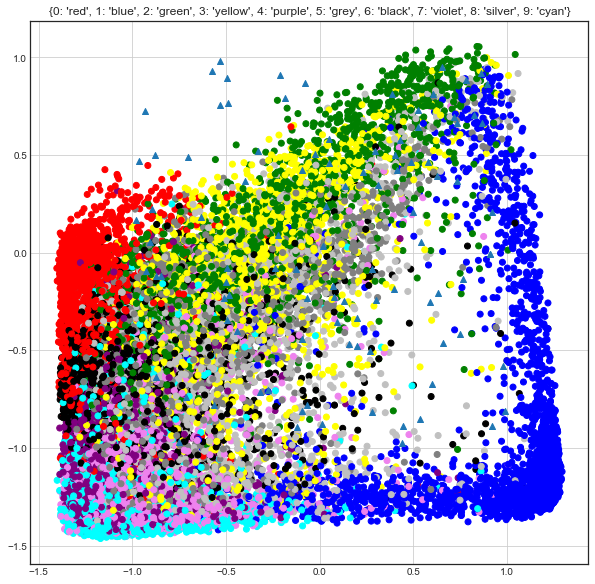

 iter: 51 batch: 19900 recon cost: 0.20306224

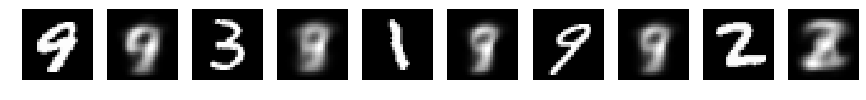

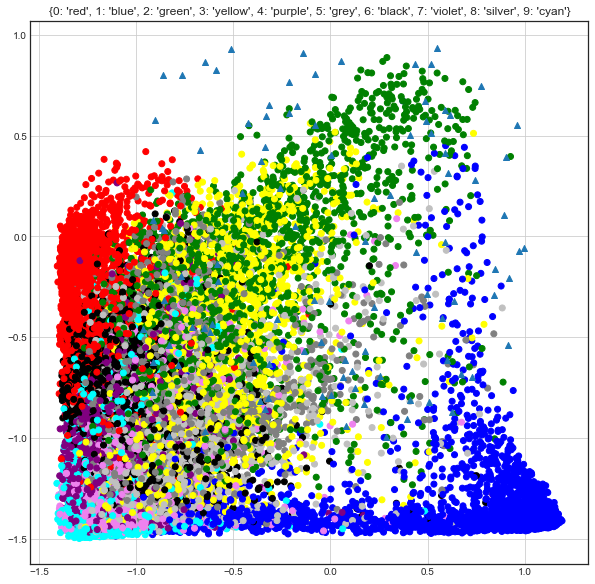

 iter: 52 batch: 19900 recon cost: 0.19647558

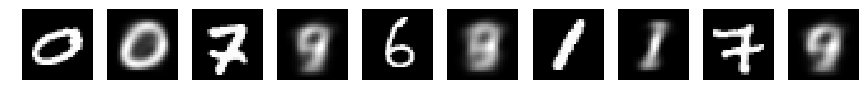

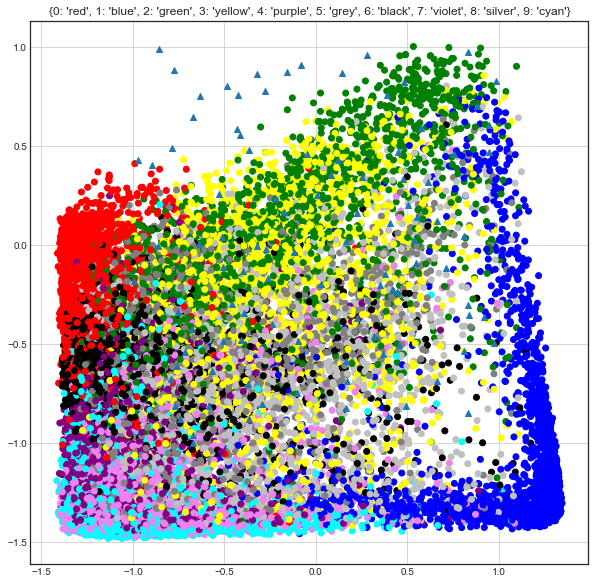

 iter: 53 batch: 19900 recon cost: 0.19542034

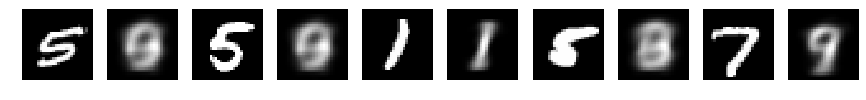

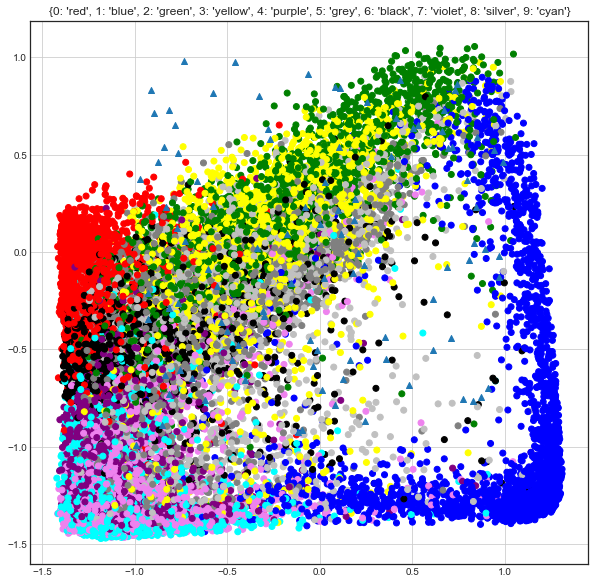

 iter: 54 batch: 19900 recon cost: 0.19457263

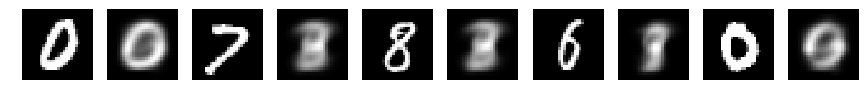

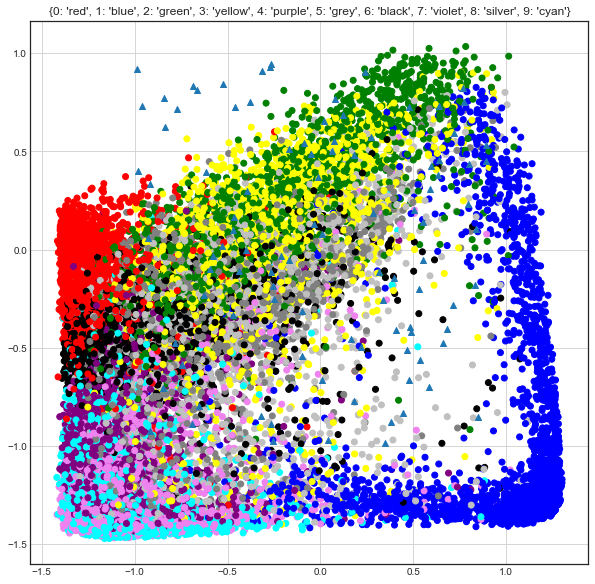

 iter: 55 batch: 19900 recon cost: 0.19383137

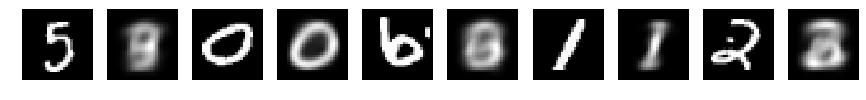

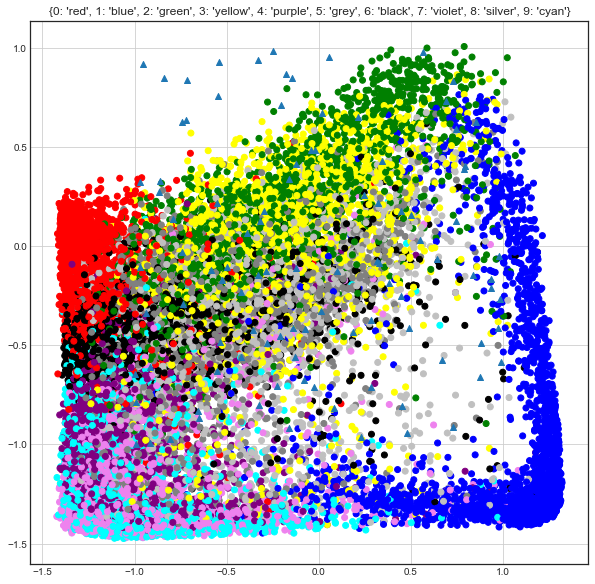

 iter: 56 batch: 19900 recon cost: 0.19902964

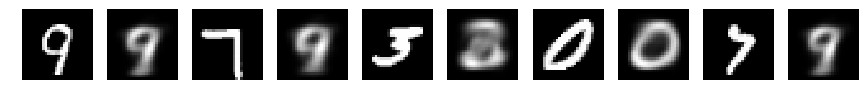

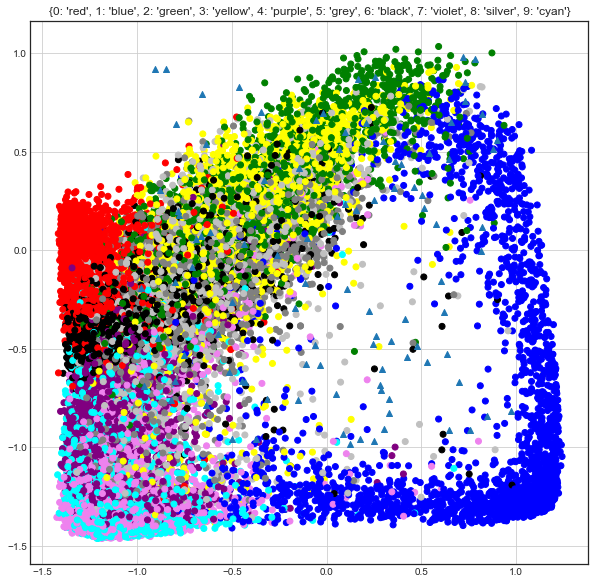

 iter: 57 batch: 19900 recon cost: 0.19285583

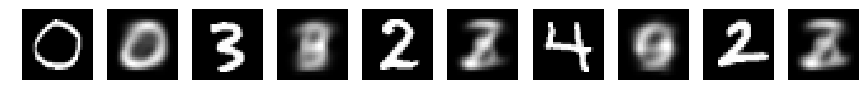

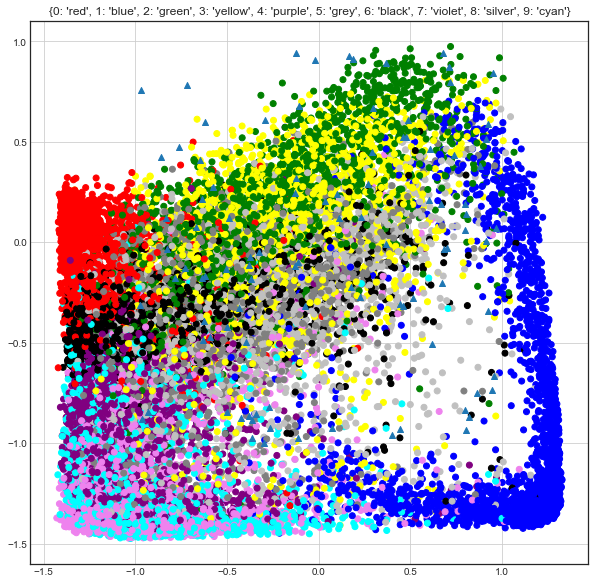

 iter: 58 batch: 19900 recon cost: 0.19284897

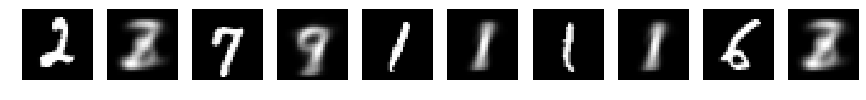

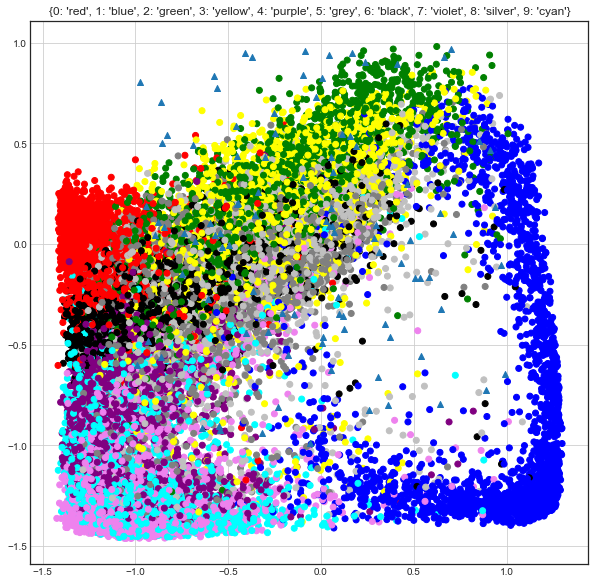

 iter: 59 batch: 19900 recon cost: 0.19165866

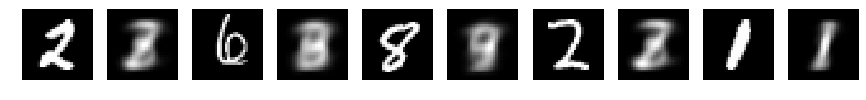

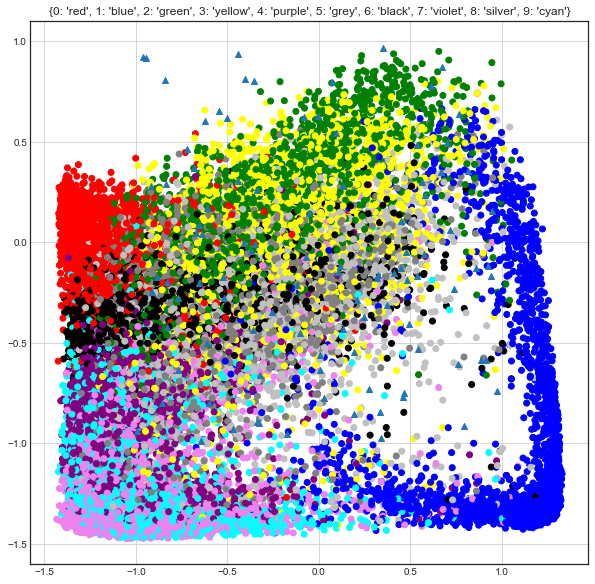

 iter: 60 batch: 19900 recon cost: 0.19335143

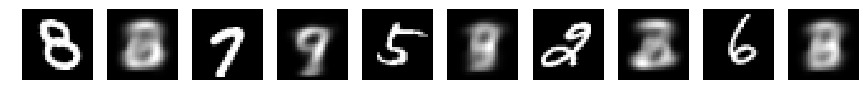

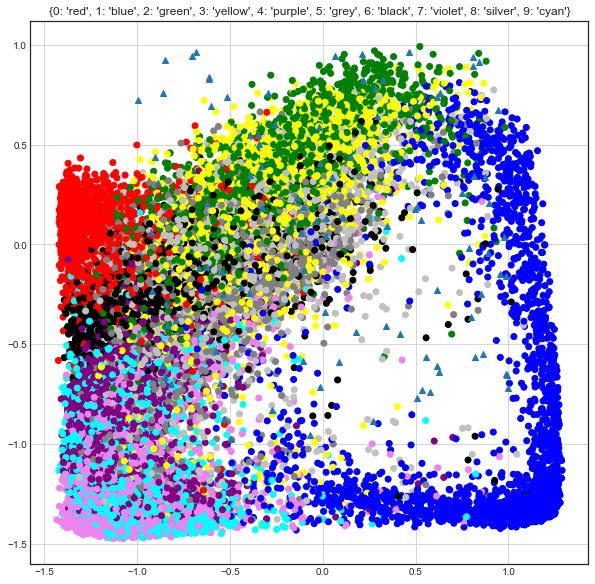

 iter: 61 batch: 19900 recon cost: 0.19145453

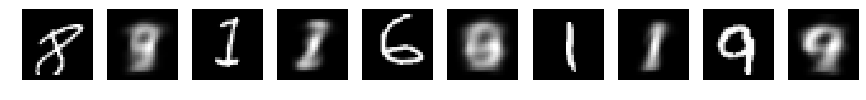

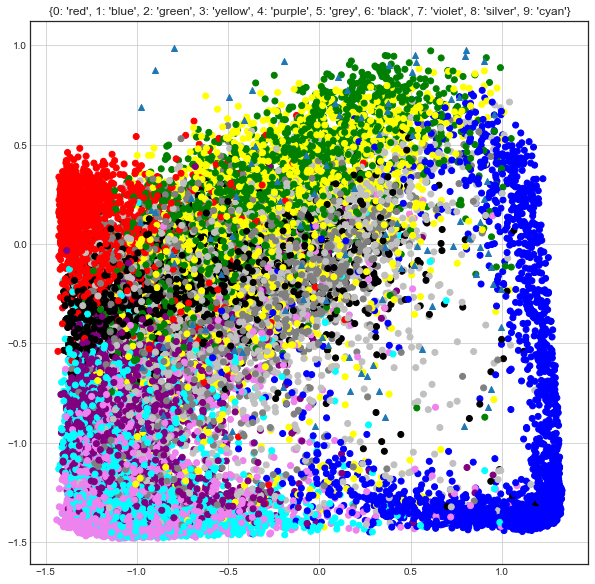

 iter: 62 batch: 19900 recon cost: 0.19063385

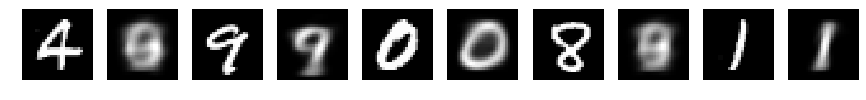

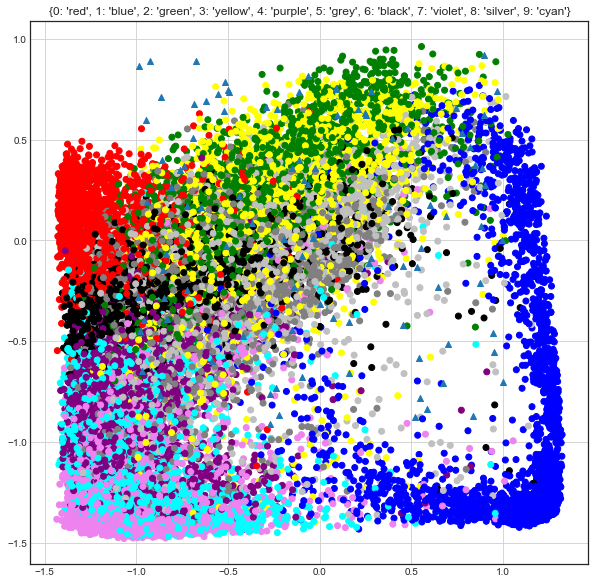

 iter: 63 batch: 19900 recon cost: 0.19594695

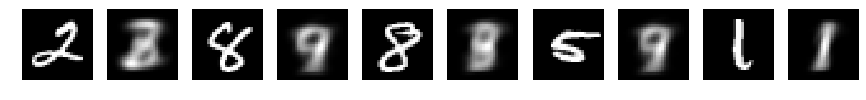

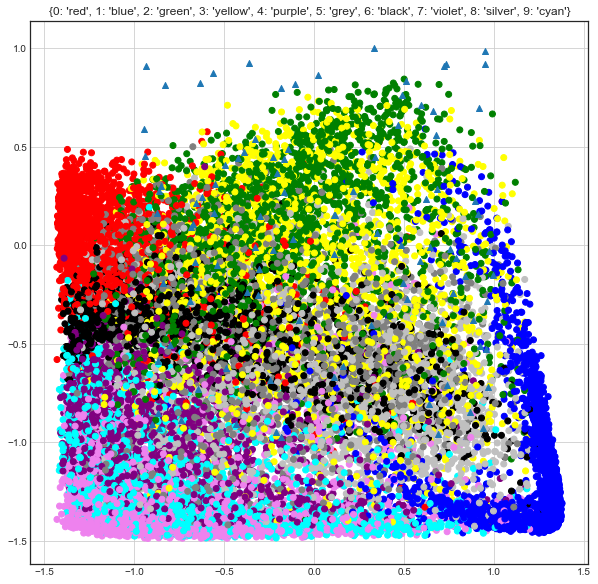

 iter: 64 batch: 19900 recon cost: 0.18952748

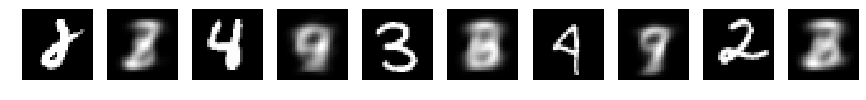

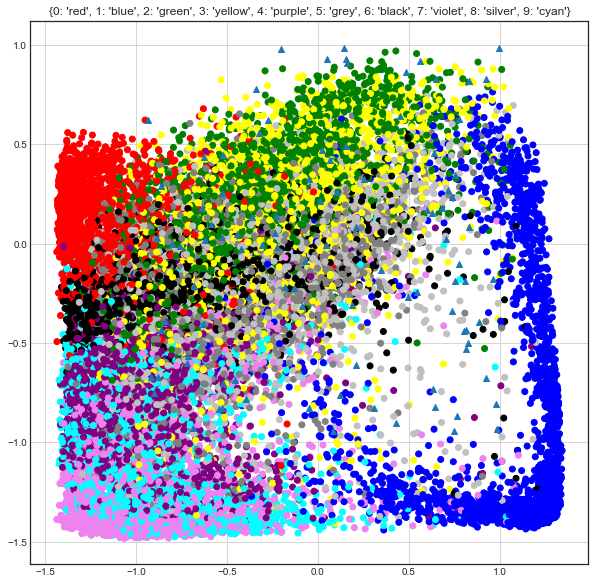

 iter: 65 batch: 19900 recon cost: 0.18909425

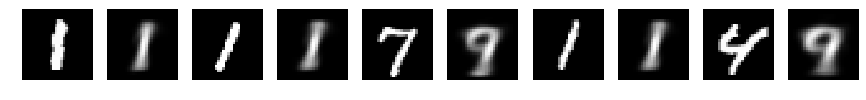

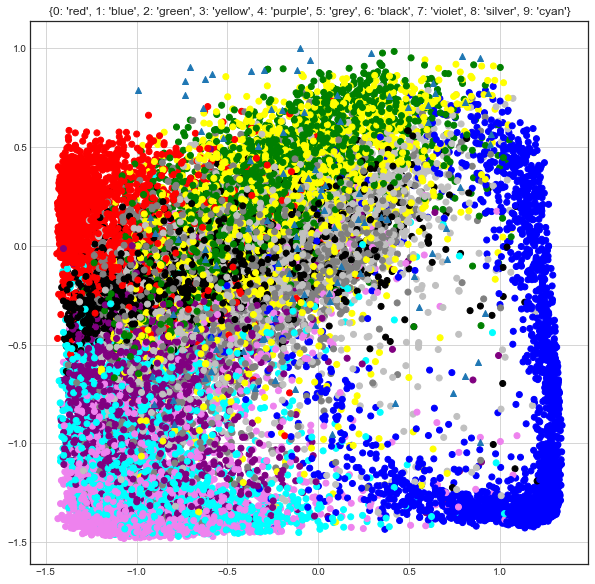

 iter: 66 batch: 19900 recon cost: 0.18958348

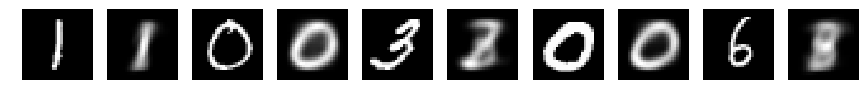

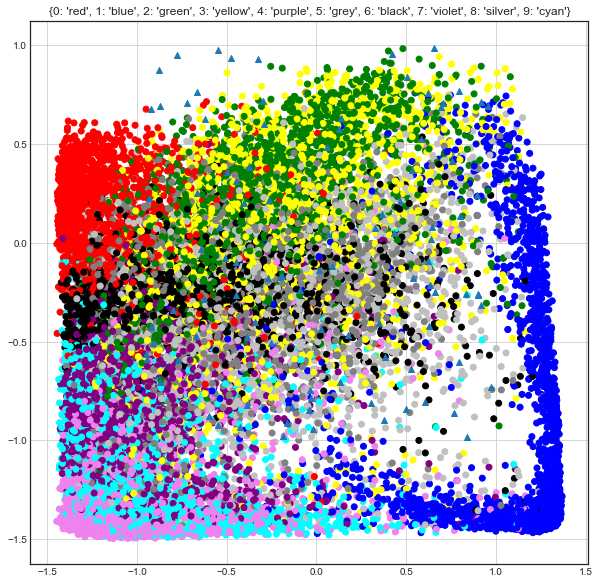

 iter: 67 batch: 19900 recon cost: 0.18987264

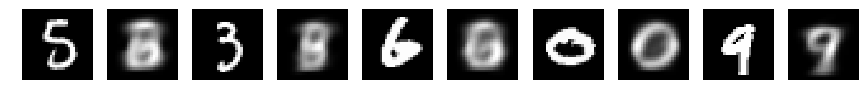

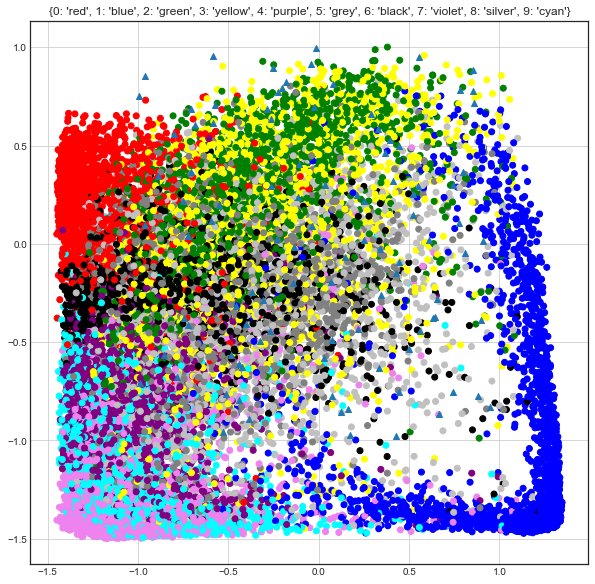

 iter: 68 batch: 19900 recon cost: 0.18877695

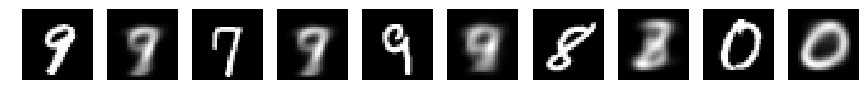

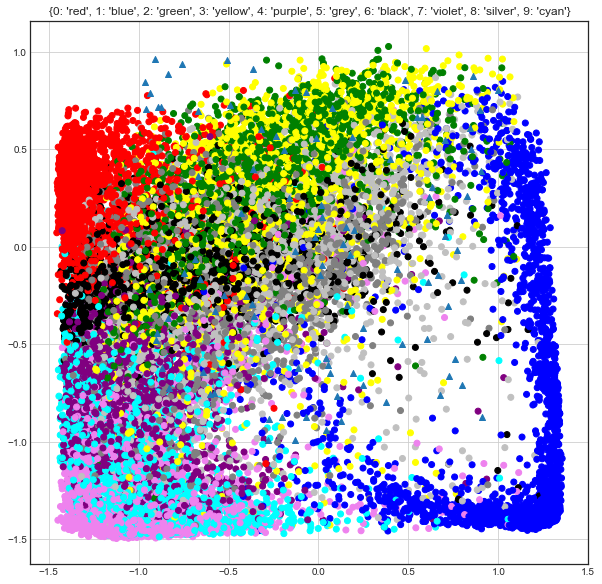

 iter: 69 batch: 19900 recon cost: 0.18798512

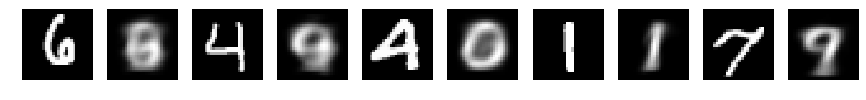

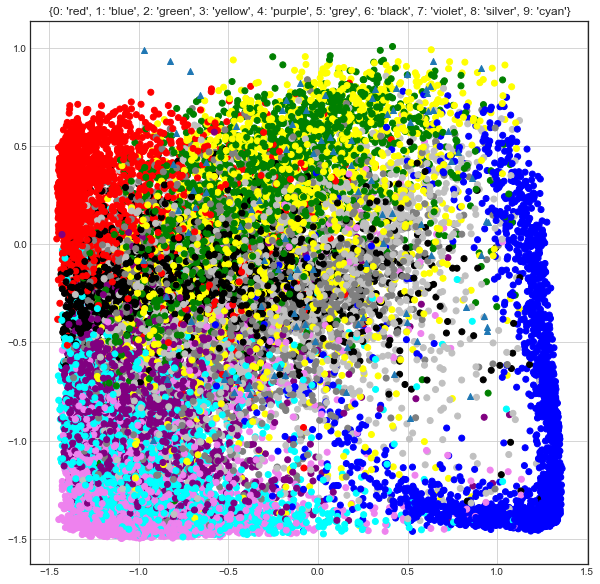

 iter: 70 batch: 19900 recon cost: 0.18779029

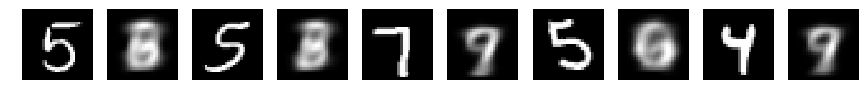

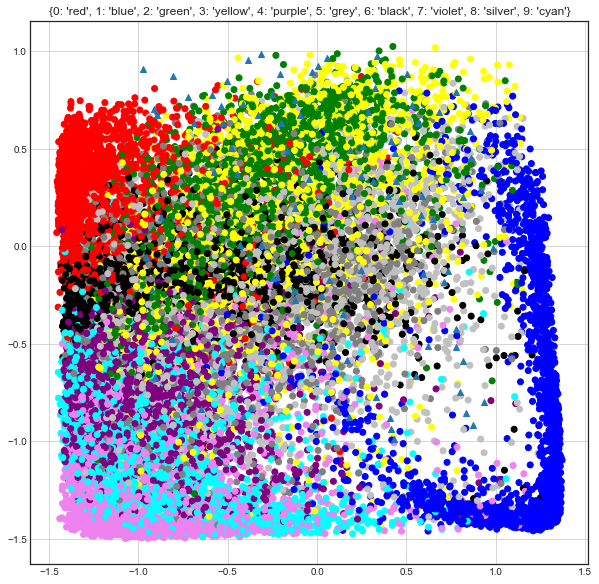

 iter: 71 batch: 19900 recon cost: 0.18733047

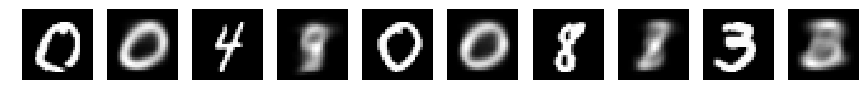

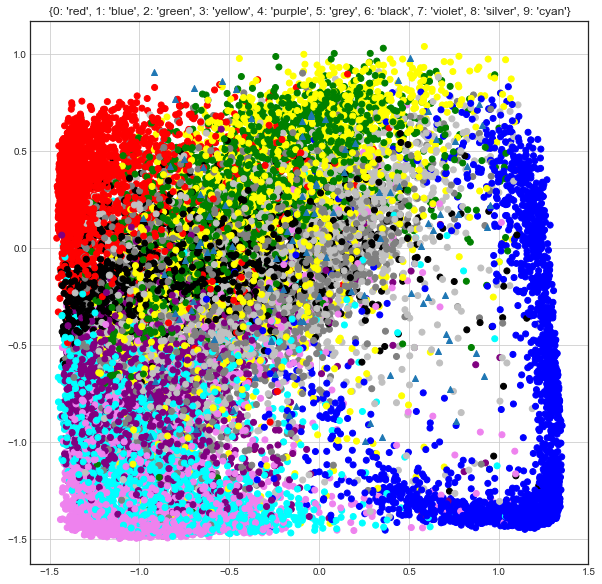

 iter: 72 batch: 19900 recon cost: 0.18697119

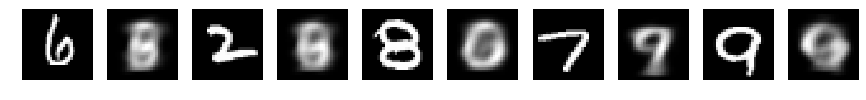

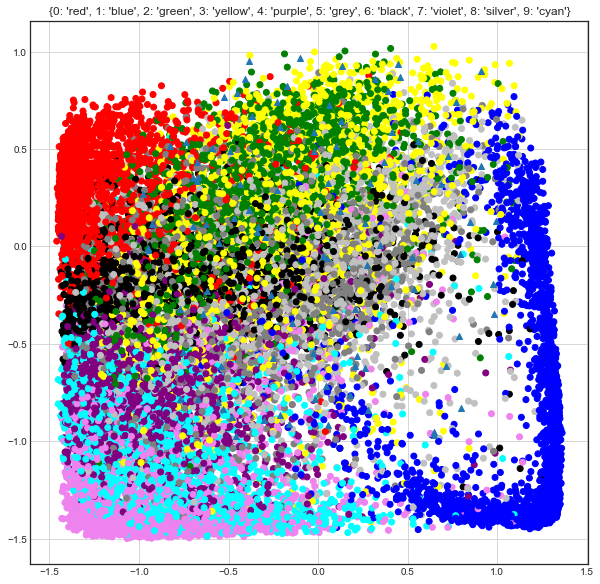

 iter: 73 batch: 19900 recon cost: 0.18725567

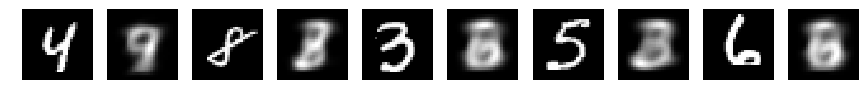

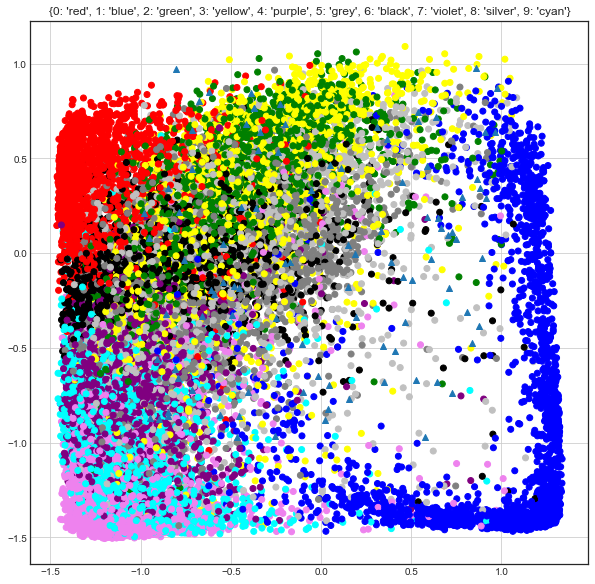

 iter: 74 batch: 19900 recon cost: 0.18630697

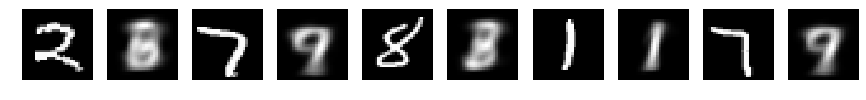

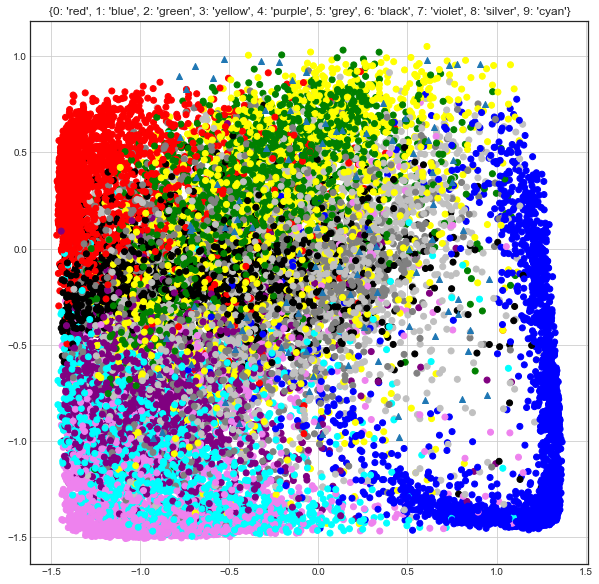

 iter: 75 batch: 19900 recon cost: 0.18655536

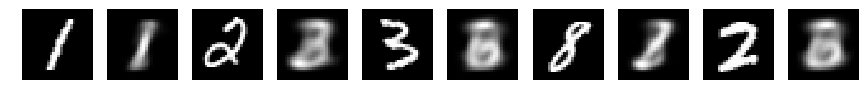

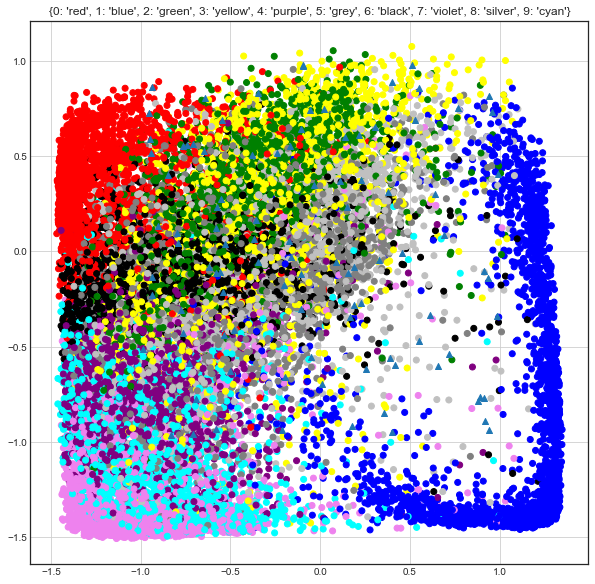

 iter: 76 batch: 19900 recon cost: 0.18585628

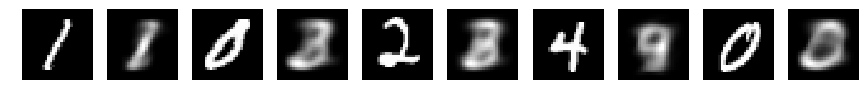

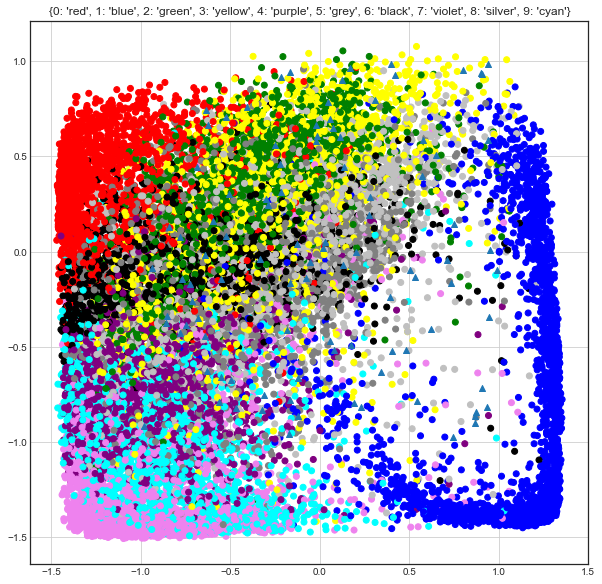

 iter: 77 batch: 19900 recon cost: 0.18533723

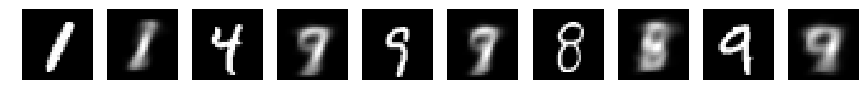

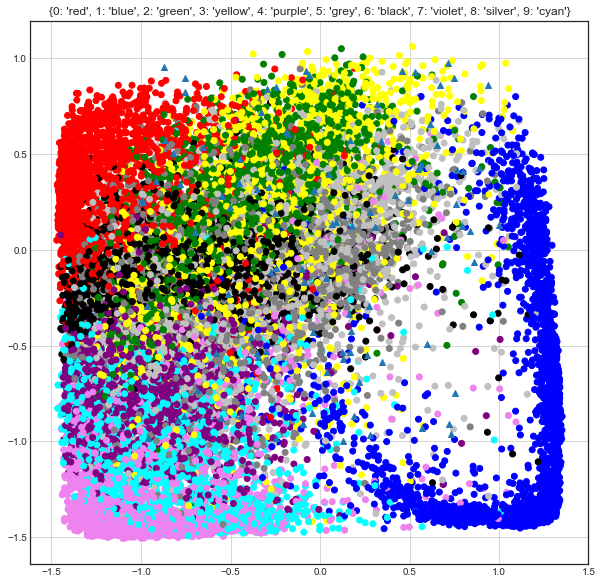

 iter: 78 batch: 19900 recon cost: 0.18780915

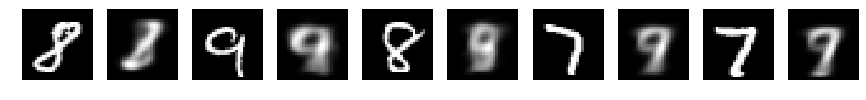

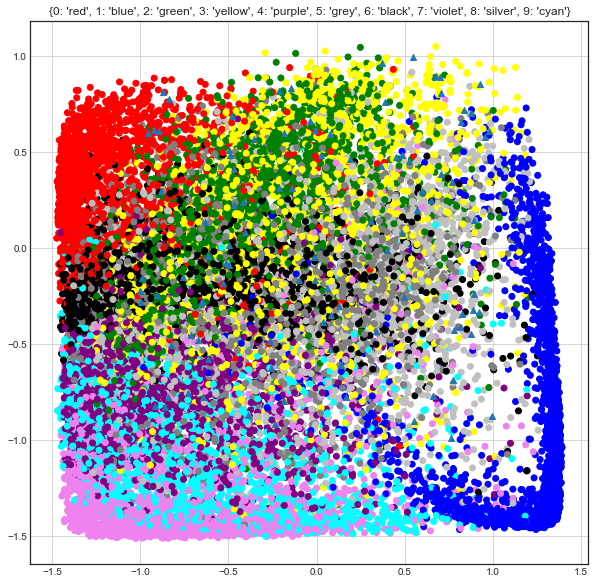

 iter: 79 batch: 19900 recon cost: 0.19266539

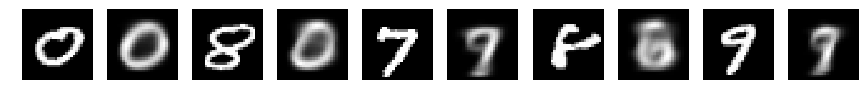

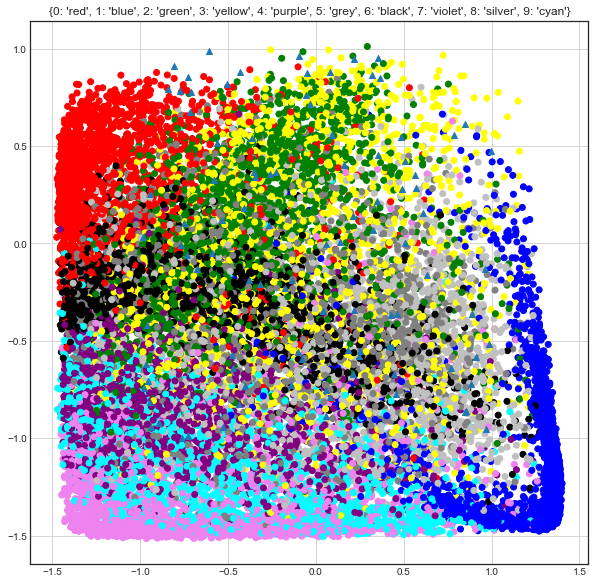

 iter: 80 batch: 19900 recon cost: 0.18493193

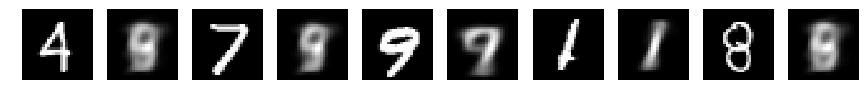

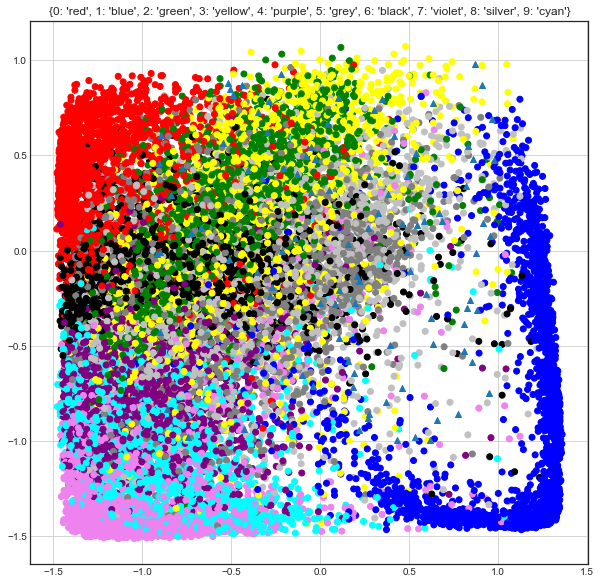

 iter: 81 batch: 19900 recon cost: 0.18446495

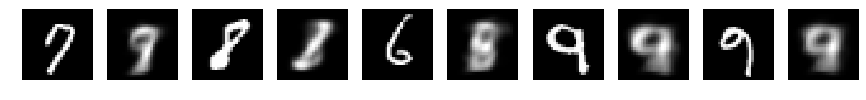

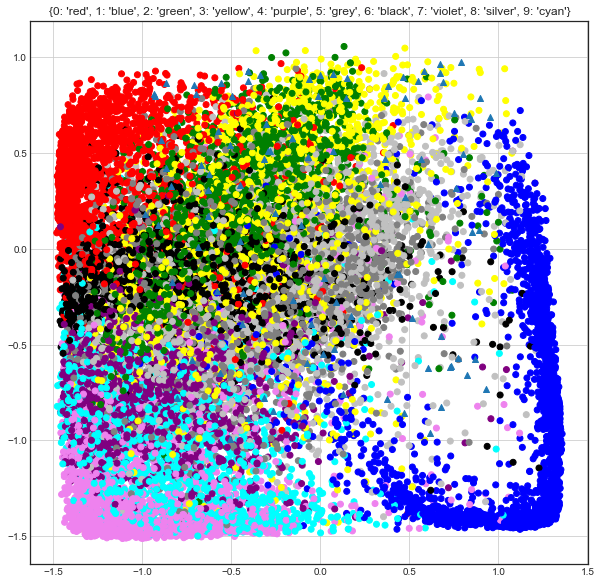

 iter: 82 batch: 19900 recon cost: 0.18492477

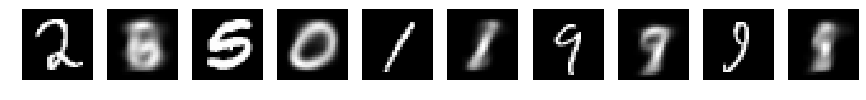

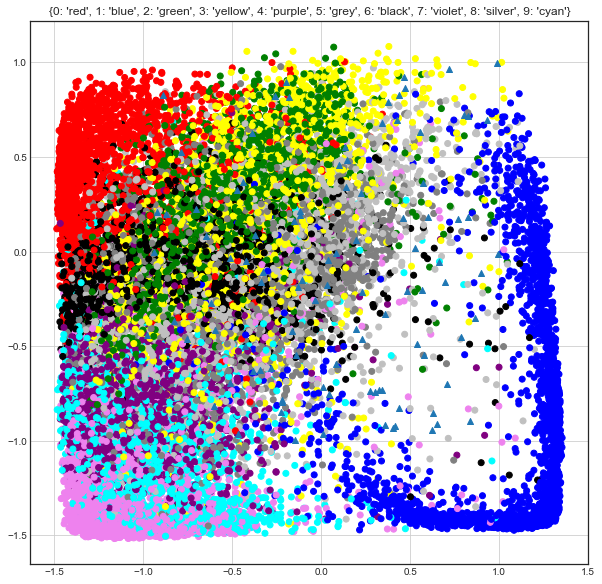

 iter: 83 batch: 19900 recon cost: 0.18400472

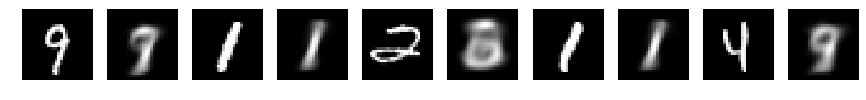

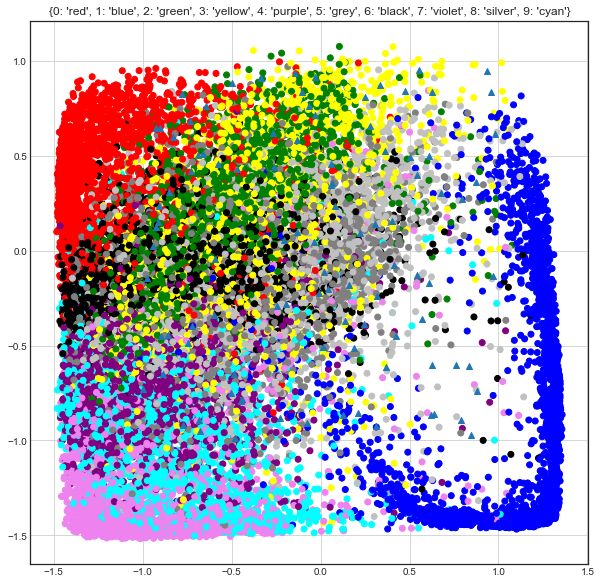

 iter: 84 batch: 19900 recon cost: 0.18413721

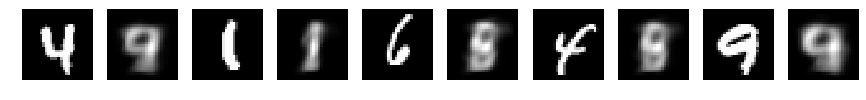

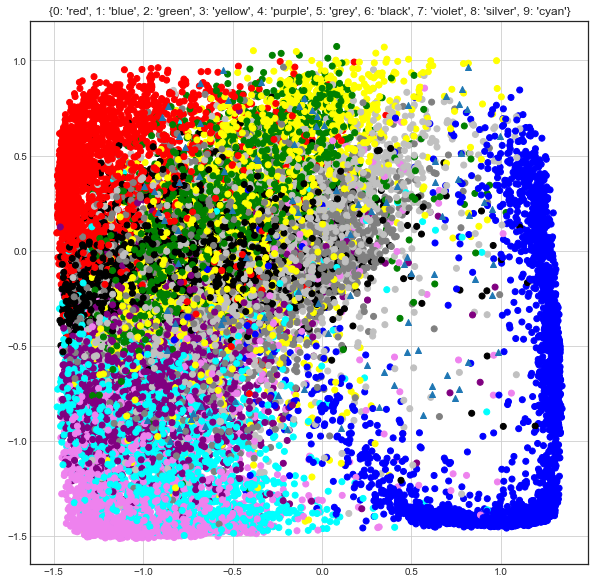

 iter: 85 batch: 19900 recon cost: 0.18520619

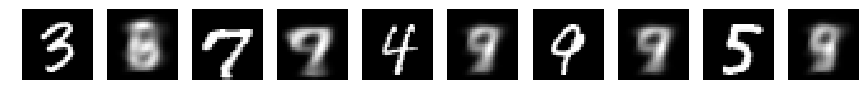

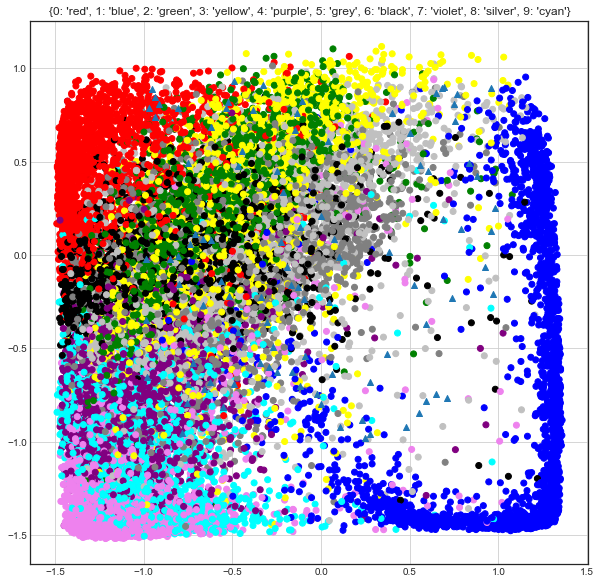

 iter: 86 batch: 19900 recon cost: 0.18365616

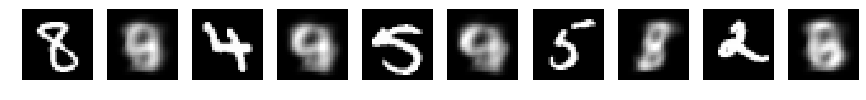

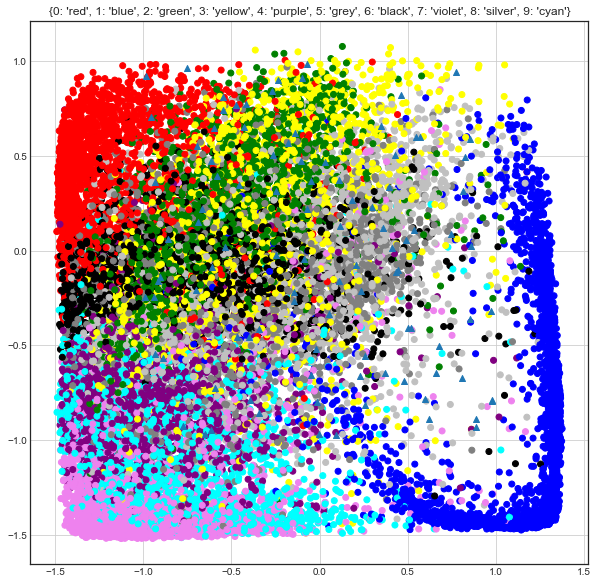

 iter: 87 batch: 19900 recon cost: 0.18496738

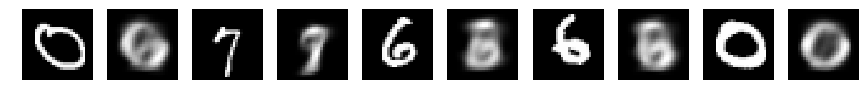

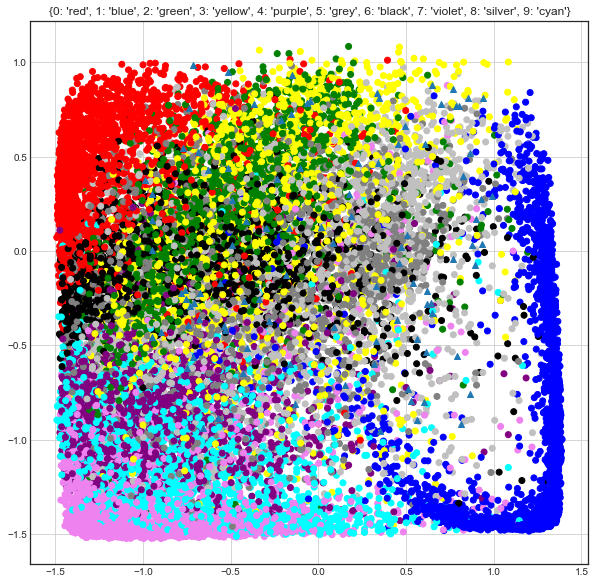

 iter: 88 batch: 19900 recon cost: 0.18437964

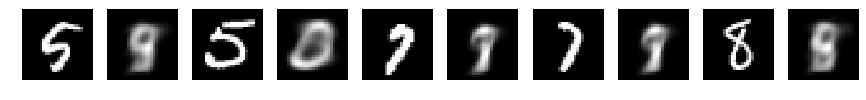

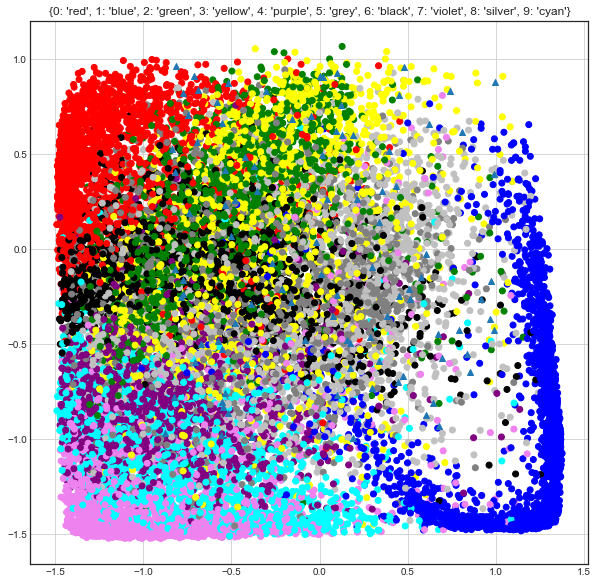

 iter: 89 batch: 19900 recon cost: 0.18362984

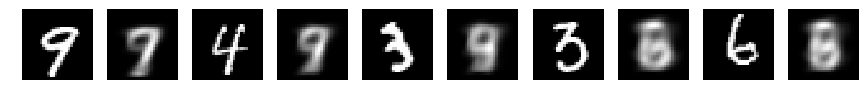

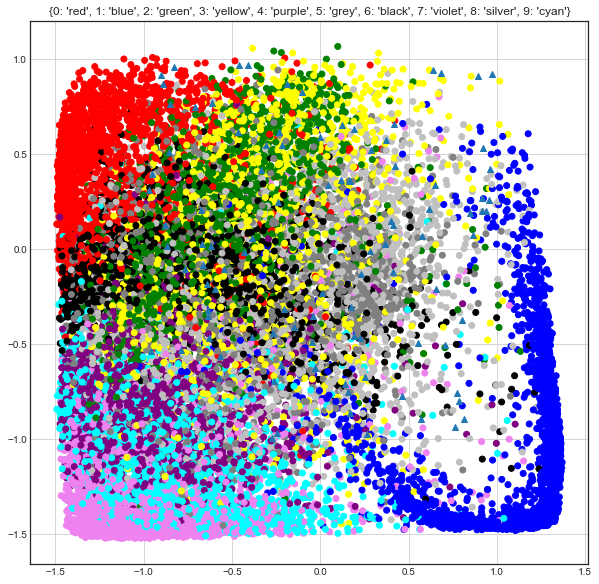

 iter: 90 batch: 19900 recon cost: 0.18339091

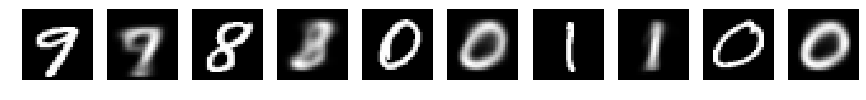

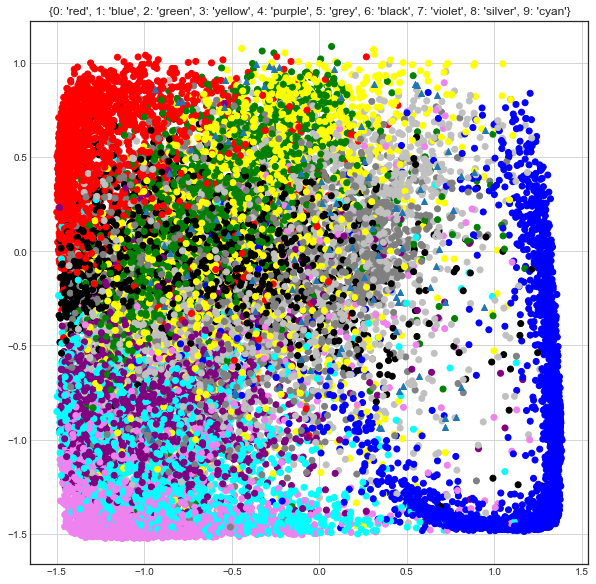

 iter: 91 batch: 19900 recon cost: 0.18275563

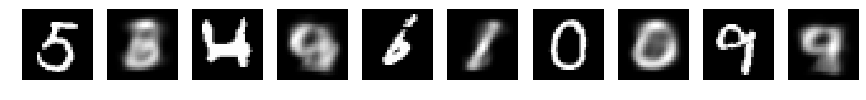

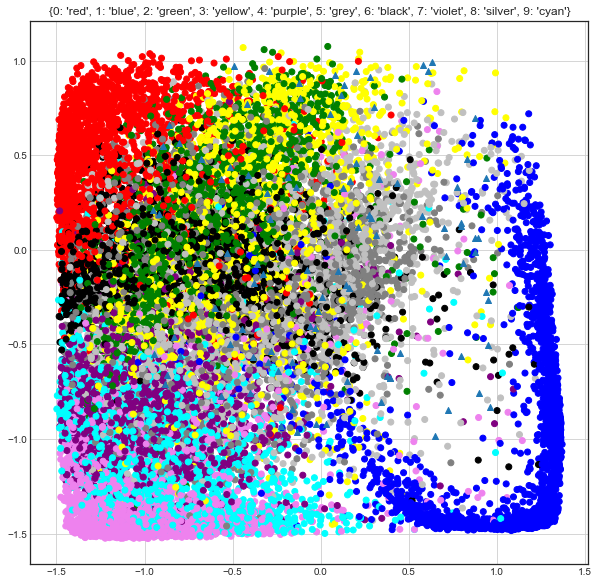

 iter: 92 batch: 19900 recon cost: 0.19009474

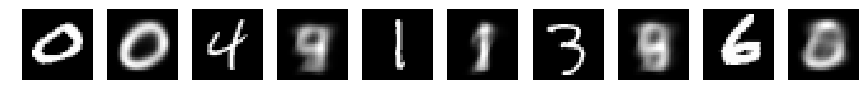

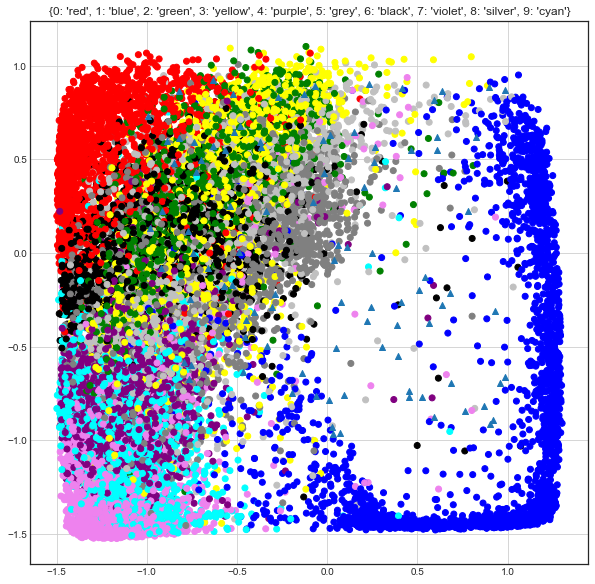

 iter: 93 batch: 19900 recon cost: 0.18253884

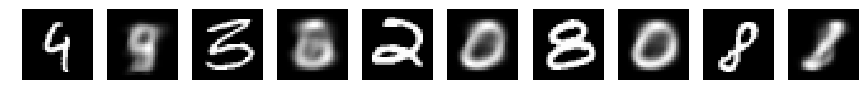

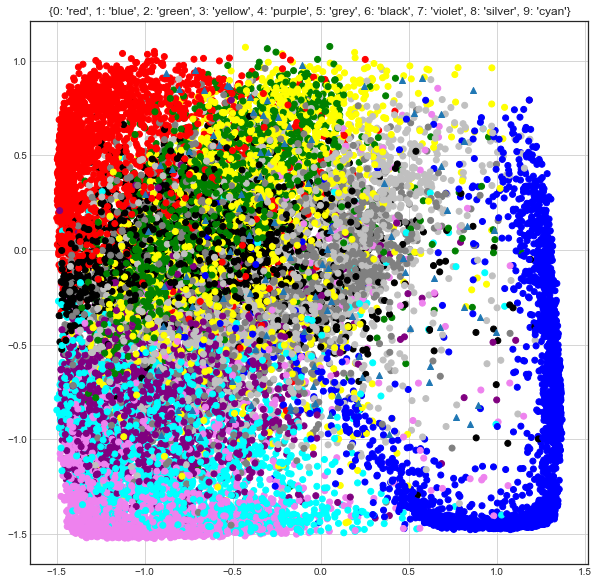

 iter: 94 batch: 19900 recon cost: 0.18305679

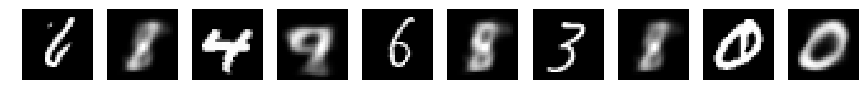

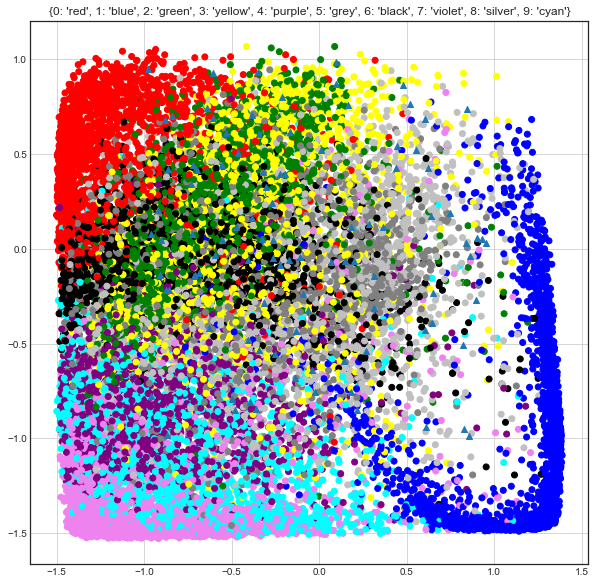

 iter: 95 batch: 19900 recon cost: 0.18186036

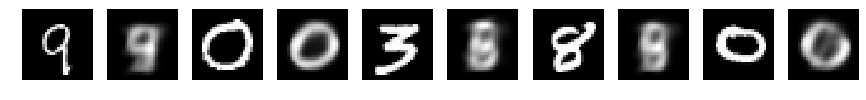

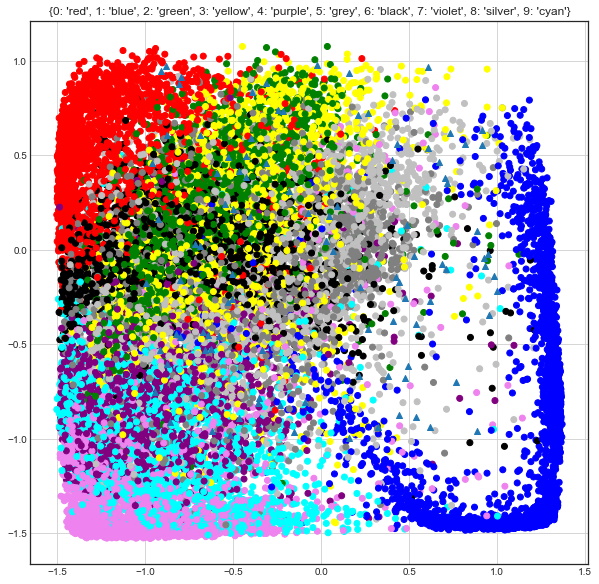

 iter: 96 batch: 19900 recon cost: 0.18486985

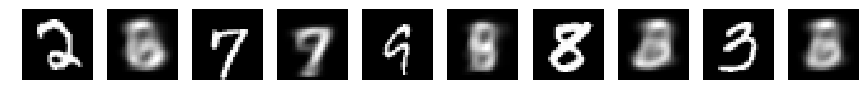

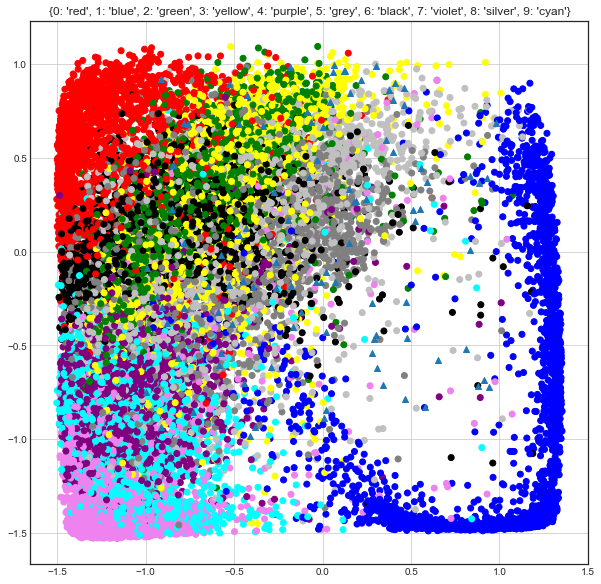

 iter: 97 batch: 19900 recon cost: 0.18265004

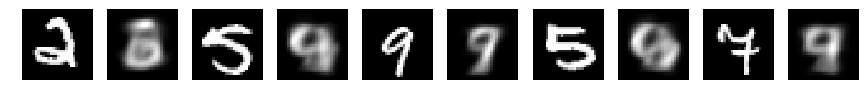

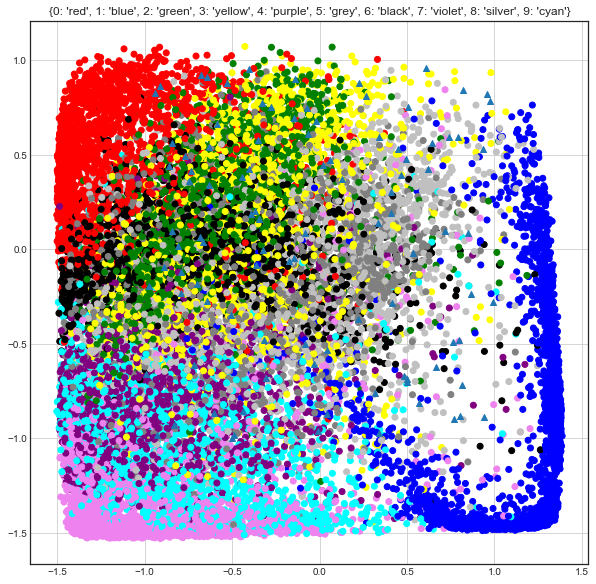

 iter: 98 batch: 19900 recon cost: 0.18171887

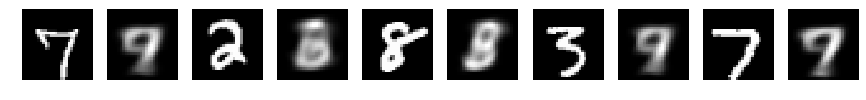

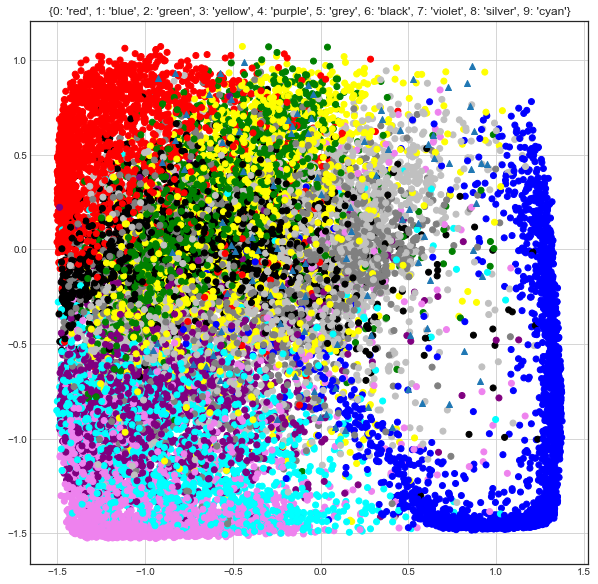

 iter: 99 batch: 19900 recon cost: 0.18129678

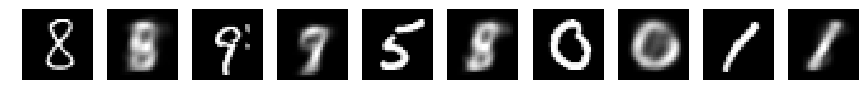

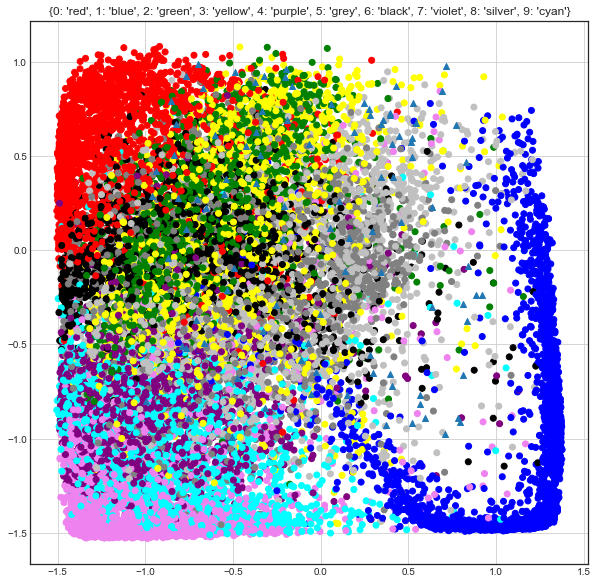

 iter: 100 batch: 19900 recon cost: 0.18166104

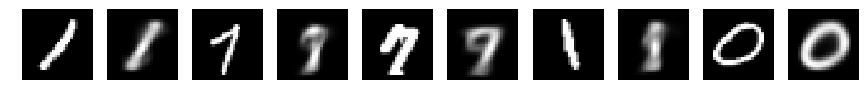

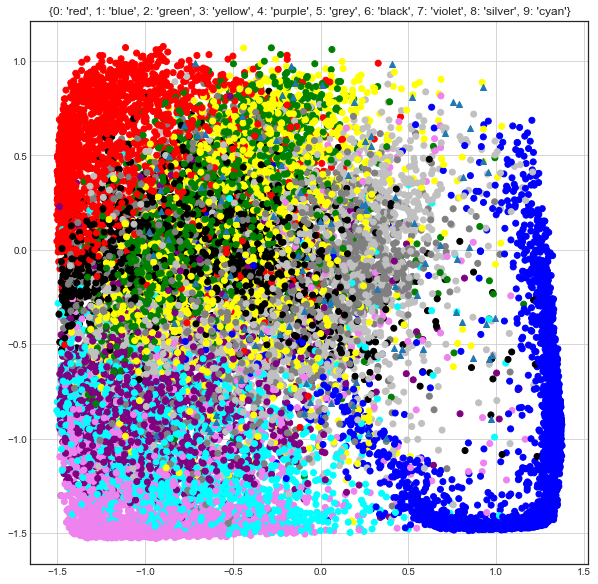

In [225]:
# start the session
try:
    sess.run(tf.global_variables_initializer())
except:
    sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())
train_batch_shuffled = train_batch.copy()
color_dict = {0:'red',1:'blue',2:'green',3:'yellow',4:'purple',5:'grey',6:'black',7:'violet',8:'silver',9:'cyan'}

for iter in range(num_epoch):
    for current_data_index in range(0,len(train_batch),batch_size):
        prior_z      = np.random.uniform(low=-1.0, high=1.0,size=(batch_size, 2)).astype(np.float32)
        current_data = train_batch_shuffled[current_data_index:current_data_index+batch_size].astype(np.float32)
    
        sess_result0 = sess.run([recon_cost,grad0_update],
        feed_dict={
            x0:current_data.reshape((batch_size,-1)),
            lr0:0.0001
        })

        sys.stdout.write('\r iter: ' + str(iter) + ' batch: ' + str(current_data_index) + \
            ' recon cost: ' + str(sess_result0[0]) 
        ); sys.stdout.flush()
        
        
    if iter % print_size == 0:
        random_idx = np.random.permutation(len(train_batch_shuffled))
        temp_data  = train_batch_shuffled[random_idx][:batch_size].reshape((batch_size,-1))
        sess_result = sess.run(dlayer3,
                      feed_dict={x0:temp_data }).reshape((batch_size,28,28))
        fig=plt.figure(figsize=(15, 15)); columns = 10 ; rows = 1
        for i in range(1, columns*rows +1):
            fig.add_subplot(rows, columns, i)
            if i % 2 ==0 :
                  plt.imshow(np.squeeze(sess_result[i-2]),cmap='gray')
            else:
                plt.imshow(np.squeeze(temp_data[i-1]).reshape((28,28)),cmap='gray')
            plt.axis('off')
        plt.show()
        
        # Show the latent space        
        all_latent_vectors = sess.run(elayer3,feed_dict={x0:temp_data})
        for current_batch_index in range(batch_size,len(train_batch), batch_size):
            current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
            sess_results = sess.run(elayer3,feed_dict={x0:current_train_data.reshape((batch_size,-1))})
            all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
        fig = plt.figure(figsize=(10,10))
        color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
        plt.title(str(color_dict))
        plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
        plt.scatter(prior_z[:,0],prior_z[:,1],marker='^')
#         plt.xlim(-15,15);plt.ylim(-15,15);
        plt.grid();plt.show()

In [ ]:
# convert every data into latent to know the statistics
all_latent_vectors = sess.run(elayer3,feed_dict={x:train_batch[:batch_size].reshape((batch_size,-1))})
print(train_batch.shape)
print(all_latent_vectors.shape)
for current_batch_index in range(batch_size,len(train_batch), batch_size):
    current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
    sess_results = sess.run(elayer3,feed_dict={x:current_train_data.reshape((batch_size,-1))})
    all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
print(all_latent_vectors.shape)

In [ ]:
# view the latent vectors
fig = plt.figure(figsize=(10,10))
color_dict = {
    0:'red',
    1:'blue',
    2:'green',
    3:'yellow',
    4:'purple',
    5:'grey',
    6:'black',
    7:'violet',
    8:'silver',
    9:'cyan',
}
color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
plt.title(str(color_dict))
plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
plt.grid()
plt.show()